# **Note - This version contains the complete implementation but omits some configurations, experiments, and results. (Easier Review)**
This Jupyter notebook is a simplified version of my full code notebook. It includes the complete implementation but omits some configurations, experiments, and results.

If you're mainly interested in reviewing the core code, this version is ideal.
To explore all experimental setups and results in detail, please refer to the full notebook.

# **Discrete Variational Autoencoder (dVAE)**

## **Visualization Functions**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
import torchvision.utils as vutils
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
import random
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist


def compute_clustering_metrics(latents, labels):
    """
    Computes clustering quality metrics from latent representations.

    Parameters:
    - latents (np.ndarray): Latent representations of the data.
    - labels (np.ndarray): Ground truth labels corresponding to the data.

    Returns:
    - intra_class_distance (float): Average intra-class distance to class centroids.
    - inter_class_distance (float): Average distance between class centroids.
    """
    class_centroids = []
    intra_dists = []

    for digit in np.unique(labels):
        digit_latents = latents[labels == digit]
        if len(digit_latents) == 0:
            continue
        centroid = digit_latents.mean(axis=0)
        class_centroids.append(centroid)

        # Intra-class distance: average distance to centroid
        dists = cdist(digit_latents, [centroid])
        intra_dists.append(dists.mean())

    # Inter-class distance: average pairwise distance between centroids
    inter_dists = cdist(class_centroids, class_centroids)
    inter_class_distance = inter_dists[np.triu_indices(len(class_centroids), k=1)].mean()

    return np.mean(intra_dists), inter_class_distance
# from sklearn.manifold import TSNE
# import umap.umap_ as umap
# Function to clamp values between 0 and 1
def to_img(x):
    return x.clamp(0, 1)

# Function to display an image
def show_image(img):
    img = to_img(img)
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis("off")

# Function to visualize reconstructed images for dVAE
def visualize_output(images, model, temp=0.8, hard=True):
    """
    Visualizes the reconstructed images from a discrete VAE model.

    Parameters:
    - images (Tensor): Input batch of images.
    - model (torch.nn.Module): Trained dVAE model.
    - temp (float): Gumbel-Softmax temperature.
    - hard (bool): Whether to use hard sampling.
    """
    images = images.to(device)

    with torch.no_grad():
        # Sample images from dVAE

        reconstructed_images = model.sample_img(images, temp, hard)

        # Move to CPU and clamp to valid range
        reconstructed_images = reconstructed_images.cpu()
        reconstructed_images = to_img(reconstructed_images)

        # Arrange images in a grid
        np_imagegrid = vutils.make_grid(reconstructed_images[:26], nrow=13, padding=5).numpy()
        plt.imshow(np.transpose(np_imagegrid, (1, 2, 0)))
        plt.axis("off")
        plt.show()




def plot_latent_space(model, dataloader, epoch, temperature=0.8, hard=False, method='pca', perplexity=30):
    """
    Plots the 2D latent space of the model using PCA or other dimensionality reduction techniques.

    Parameters:
    - model (torch.nn.Module): Trained dVAE model.
    - dataloader (DataLoader): DataLoader providing (image, label) pairs.
    - epoch (int): Current training epoch (used for labeling plots).
    - temperature (float): Gumbel-Softmax temperature.
    - hard (bool): Whether to use hard (discrete) sampling for latent codes.
    - method (str): Dimensionality reduction method ('pca' supported).
    - perplexity (int): Perplexity used in methods like t-SNE (unused here).

    Displays:
    - Scatter plot of latent space colored by digit labels.
    - Prints intra- and inter-class distances for cluster quality evaluation.
    """

    model.eval()
    latents = []
    labels = []

    with torch.no_grad():
        for data, label in dataloader:
            data = data.to(device)
            logits_z = model.encode(data).view(-1, latent_dim, categorical_dim)

            # Get relaxed or hard latent representations
            latent_z = gumbel_softmax(logits_z, temperature, hard)
            if not hard:
                latent_z = latent_z.view(-1, latent_dim * categorical_dim)  # (batch_size, latent_dim * categorical_dim)
            else:
                latent_z = latent_z.view(-1, latent_dim, categorical_dim)
                latent_z = latent_z.argmax(dim=-1)  # (batch_size, latent_dim)
            latents.append(latent_z.cpu().numpy())
            labels.append(label.cpu().numpy())

    latents = np.concatenate(latents, axis=0)
    labels = np.concatenate(labels, axis=0).astype(int)

    intra, inter = compute_clustering_metrics(latents, labels)
    print(f"[Temp={temperature}] Intra-class distance: {intra:.4f}, Inter-class distance: {inter:.4f}")
    # Dimensionality reduction
    if not hard:
        if method == 'pca':
            reducer = PCA(n_components=2)
            latents_2d = reducer.fit_transform(latents)

        # elif method == 'umap':
        #     reducer = umap.UMAP(n_components=2, random_state=42)
        #     latents_2d = reducer.fit_transform(latents)
        else:
            raise ValueError(f"Unknown reduction method: {method}")
    else:
        # If hard=True, latents are already in discrete form; reduce with PCA for visualization
        reducer = PCA(n_components=2)
        latents_2d = reducer.fit_transform(latents)

    # Ensure shape match
    if latents_2d.shape[0] != labels.shape[0]:
        print(f"Shape Mismatch: latents={latents_2d.shape}, labels={labels.shape}")
        labels = labels[:latents_2d.shape[0]]

    # Plot
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(latents_2d[:, 0], latents_2d[:, 1], c=labels, cmap='tab10', alpha=0.7)
    plt.colorbar(scatter, label="MNIST Digit Class")
    plt.xlabel("Latent Variable 1")
    plt.ylabel("Latent Variable 2")
    plt.title(f"Latent Space ({method.upper()}) | temp={temperature} | epoch={epoch}")
    plt.grid()
    plt.show()



def plot_latent_discrete_grid(model, latent_dim, categorical_dim,epoch, temp=0.8):
    """
    Plots all possible latent states in a grid without spaces between images.

    Args:
        model (nn.Module): The trained dVAE model.
        latent_dim (int): Number of latent categorical variables (N). (Default: 2)
        categorical_dim (int): Number of possible categories per variable (K). (Default: 10)
        temp (float): Temperature for Gumbel-Softmax sampling.

    Returns:
        Displays a grid of reconstructed images at their (i, j) locations.
    """

    # Ensure device is correctly assigned
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()  # Set model to evaluation mode

    # Define batch size as the total number of states (10x10=100)
    dic = {}

    # Iterate over all possible discrete states
    for i in range(categorical_dim):
        for j in range(categorical_dim):
            latent_logits = torch.zeros(1, latent_dim, categorical_dim, device=device)  # Create zero logits

            latent_logits[0, 0, i] = 1  # Set first latent variable
            latent_logits[0, 1, j] = 1  # Set second latent variable
            latent_logits = latent_logits.view(1, -1)

            dic[(i, j)] = latent_logits  # Store latent representation

    # Decode images and store them in a new dictionary
    decoded_images = {}
    for (i, j), latent_vector in dic.items():
        with torch.no_grad():
            reconst_image = model.decode(latent_vector)  # Decode the latent vector
            reconst_image = reconst_image.view(28, 28).detach().cpu().numpy()  # Convert to NumPy array
            decoded_images[(i, j)] = reconst_image  # Store decoded image

    # Create a single large figure
    fig, ax = plt.subplots(figsize=(8, 6))

    # Plot each reconstructed image at its correct (i, j) location
    for (i, j), img in decoded_images.items():
        ax.imshow(img, cmap='gray', extent=[j, j + 1, categorical_dim - i - 1, categorical_dim - i])

    # Set x and y axis limits
    ax.set_xlim(0, categorical_dim)
    ax.set_ylim(0, categorical_dim)

    # Set labels and ticks
    ax.set_xticks(range(categorical_dim))
    ax.set_yticks(range(categorical_dim))
    ax.set_xlabel("Latent Dimension 1", fontsize=12)
    ax.set_ylabel("Latent Dimension 2", fontsize=12)
    ax.set_title(f"Discrete Latent Space All States with Temp = {temp} in Epoch {epoch}", fontsize=14)

    # Show the final plotted grid
    plt.show()


## **Gumbel-Softmax Sampling Functions**

In [ ]:
def sample_gumbel(shape, eps=1e-20):
    """
    Samples noise from a Gumbel(0, 1) distribution.

    Parameters:
    - shape (tuple): Shape of the output tensor.
    - eps (float): Small constant for numerical stability.

    Returns:
    - Tensor: Gumbel noise of the specified shape.
    """
    U = torch.rand(shape, device=device)
    return -torch.log(-torch.log(U + eps))

def gumbel_softmax_sample(logits, temperature):
    """
    Draws a sample from the Gumbel-Softmax distribution (reparameterized).

    Parameters:
    - logits (Tensor): Unnormalized log-probabilities.
    - temperature (float): Temperature parameter controlling smoothness.

    Returns:
    - Tensor: Sample from the Gumbel-Softmax distribution.
    """
    y = logits + sample_gumbel(logits.size())
    return F.softmax(y / temperature, dim=-1)

def gumbel_softmax(logits, temperature, hard=False):
    """
    Applies the Gumbel-Softmax trick to produce differentiable samples
    from a categorical distribution.

    Parameters:
    - logits (Tensor): Unnormalized log-probabilities.
    - temperature (float): Temperature parameter controlling smoothness.
    - hard (bool): If True, returns one-hot encoded vectors using
      the straight-through estimator.

    Returns:
    - Tensor: Gumbel-Softmax sample (either soft or hard one-hot).
    """
    y = gumbel_softmax_sample(logits, temperature)
    if not hard:
        return y.view(-1, latent_dim * categorical_dim)

    # Hard Gumbel-Softmax (Straight-Through Estimation)
    shape = y.size()
    _, ind = y.max(dim=-1)
    y_hard = torch.zeros_like(y).view(-1, shape[-1])
    y_hard.scatter_(1, ind.view(-1, 1), 1)
    y_hard = y_hard.view(*shape)
    y_hard = (y_hard - y).detach() + y
    return y_hard.view(-1, latent_dim * categorical_dim)


## **Discrete VAE Training**

In [ ]:
# ----------------------------
# ✅ HyperParameters
# ----------------------------
latent_dim = 2
categorical_dim = 10
capacity = 64  # Model capacity (number of conv channels)
batch_size = 128
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
def dVAE_Train(temper, epochs, seed, batch_size=128, capacity=64, latent_dim=2, categorical_dim=10,min_temp=0.5,anneal_rate = 0.0003,anneal=False):
    """
    Trains a discrete VAE (dVAE) using the Gumbel-Softmax trick on the MNIST dataset.

    Parameters:
    - temper (float): Initial Gumbel-Softmax temperature. (Fixed when not using temp annealing)
    - epochs (int): Number of training epochs.
    - seed (int): Random seed for reproducibility.
    - batch_size (int): Size of each mini-batch.
    - capacity (int): Base number of channels for conv layers.
    - latent_dim (int): Number of categorical latent variables.
    - categorical_dim (int): Number of categories per latent variable.
    - min_temp (float): Minimum temperature if annealing is used.
    - anneal_rate (float): Rate of exponential temperature decay.
    - anneal (bool): Whether to apply temperature annealing.

    Returns:
    - dVAE (nn.Module): Trained dVAE model.
    - test_loader (DataLoader): DataLoader for test set.
    - train_loss_avg (list): List of average training losses per epoch.
    """
    initial_temp = temper
    temperature = temper
    hard = False
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    is_cuda = torch.cuda.is_available()
    train_loss_avg=[]
    # ----------------------------
    # ✅ Seed setting to reproduce results
    # ----------------------------
    seed_value = 38
    random.seed(seed_value)
    np.random.seed(seed_value)
    torch.manual_seed(seed_value)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed_value)
        torch.cuda.manual_seed_all(seed_value)

    # DataLoader
    train_loader = torch.utils.data.DataLoader(
        datasets.MNIST('./data/MNIST', train=True, download=True,
                      transform=transforms.ToTensor()),
        batch_size=batch_size, shuffle=True)
    test_loader = torch.utils.data.DataLoader(
        datasets.MNIST('./data/MNIST', train=False, download=True, transform=transforms.ToTensor()),
        batch_size=batch_size, shuffle=False)



    # ----------------------------
    # ✅ dVAE Model
    # ----------------------------
    class VAE_model(nn.Module):
        """
        Discrete Variational Autoencoder (dVAE) model with Gumbel-Softmax latent variables.
        Consists of a convolutional encoder and decoder.
        """
        def __init__(self):
            super(VAE_model, self).__init__()
            c = capacity
            self.global_step = 0
            # Encoder
            self.conv1 = nn.Conv2d(1, c, kernel_size=4, stride=2, padding=1)  # 28x28 -> 14x14
            self.conv2 = nn.Conv2d(c, c * 2, kernel_size=4, stride=2, padding=1)  # 14x14 -> 7x7
            self.fc_logits = nn.Linear(c * 2 * 7 * 7, latent_dim * categorical_dim)

            # Decoder
            self.fc = nn.Linear(latent_dim * categorical_dim, c * 2 * 7 * 7)
            self.deconv2 = nn.ConvTranspose2d(c * 2, c, kernel_size=4, stride=2, padding=1)  # 7x7 -> 14x14
            self.deconv1 = nn.ConvTranspose2d(c, 1, kernel_size=4, stride=2, padding=1)  # 14x14 -> 28x28

        def encode(self, x):
            x = F.relu(self.conv1(x))
            x = F.relu(self.conv2(x))
            x = x.view(x.size(0), -1)
            return self.fc_logits(x)  # Logits for categorical distribution

        def decode(self, z):
            x = self.fc(z)
            x = x.view(x.size(0), capacity * 2, 7, 7)
            x = F.relu(self.deconv2(x))
            x = torch.sigmoid(self.deconv1(x))  # Normalize output to [0,1]
            return x

        def sample_img(self, img, temp, random=True):
            """
            Samples a reconstructed image from the model given an input image.(For evaluation purpose)

            Parameters:
            - img (Tensor): Input image tensor.
            - temp (float): Gumbel-Softmax temperature.
            - random (bool): If True, uses Gumbel-Softmax sampling; otherwise uses logits directly.

            Returns:
            - Tensor: Reconstructed image.
            """
            with torch.no_grad():
                logits_z = self.encode(img)
                logits_z = logits_z.view(-1, latent_dim, categorical_dim)
                if random:
                    latent_z = gumbel_softmax(logits_z, temp, True)
                else:
                    latent_z = logits_z.view(-1, latent_dim * categorical_dim)
                probs_x = self.decode(latent_z)

                sampled_img = probs_x

            return sampled_img

        # ----------------------------
        # ✅ Forward Function (Loss inside)
        # ----------------------------
        def forward(self, data, temp, hard):
          """
          Computes the forward pass and loss (negative ELBO) for a batch.

          Parameters:
          - data (Tensor): Batch of input images.
          - temp (float): Gumbel-Softmax temperature.
          - hard (bool): Whether to use hard sampling (one-hot vectors).

          Returns:
          - loss (Tensor): Scalar loss for optimization.
          """
          logits_z = self.encode(data).view(-1, latent_dim, categorical_dim)

          # Sample relaxed Concrete variable using standard Gumbel-Softmax (Concrete posterior)
          latent_z = gumbel_softmax(logits_z, temp, hard)
          latent_z = latent_z.view(-1, latent_dim, categorical_dim)  # Ensure correct shape

          # Decode to get the probability of each pixel
          probs_x = self.decode(latent_z.view(-1, latent_dim * categorical_dim))
          dist_x = torch.distributions.Bernoulli(probs=probs_x, validate_args=False)  # Bernoulli likelihood

          # Reconstruction Loss
          rec_loss = dist_x.log_prob(data).sum(dim=[1, 2, 3])

          # Compute relaxed posterior log-probabilities (log q_alpha)
          post_samples = gumbel_softmax(logits_z, temp, hard=False).view(-1, latent_dim, categorical_dim)  # Fix shape issue
          log_q_alpha = torch.sum(torch.log(post_samples + 1e-8) * latent_z, dim=-1)  # Compute relaxed log probability

          # Compute relaxed prior log-probabilities (log P_a) using Gumbel-Softmax
          prior_logits = torch.full_like(logits_z, fill_value=torch.log(torch.tensor(1.0 / categorical_dim, device=device)))
          prior_samples = gumbel_softmax(prior_logits, temp, hard=False).view(-1, latent_dim, categorical_dim)  # Fix shape
          log_p_a = torch.sum(torch.log(prior_samples + 1e-8) * latent_z, dim=-1)
          # Relaxed KL divergence using log-densities
          KL = (log_q_alpha - log_p_a).sum(dim=-1)

          # ELBO Loss
          elbo = rec_loss - KL
          loss = -elbo.mean()

          return loss

    # ----------------------------
    # ✅ Training Function
    # ----------------------------
    def train(epoch, model, optimizer,anneal_temp=0.8):
      """
      Trains the dVAE for a single epoch and optionally visualizes progress.

      Parameters:
      - epoch (int): Current training epoch.
      - model (nn.Module): dVAE model instance.
      - optimizer (Optimizer): Optimizer for model parameters.
      - anneal_temp (float): Temperature to use for Gumbel-Softmax sampling (can be annealed).
      """
      model.train()
      train_loss = 0
      temp = temperature
      if anneal:
        temp = anneal_temp
      for batch_idx, (data, _) in enumerate(train_loader):
          if is_cuda:
              data = data.cuda()

          optimizer.zero_grad()
          loss = model(data, temp, hard)
          loss.backward()
          train_loss += loss.item() * len(data)
          optimizer.step()


      print('-----> Epoch: {} Average loss: {:.4f}'.format(
          epoch, train_loss / len(train_loader.dataset)))
      if anneal:
        print(f'Epoch Temperature {temp}')
      train_loss_avg.append(train_loss / len(train_loader.dataset))

      device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
      model.to(device)
      if epoch % 10 == 0 or epoch==0:

        # Fetch images from the test dataloader
        images, labels = next(iter(test_loader))

        # Display original images
        print('Original images:')
        show_image(vutils.make_grid(images[:26], nrow=13, padding=5))
        plt.show()

        # Reconstruct and visualize using the dVAE
        print('dVAE reconstruction:')
        visualize_output(images, model, temp=temp, hard=True)
      if epoch % 5 == 0 or epoch==0:
        plot_latent_space(model, test_loader,epoch, temperature=temp, hard=False,method='pca')
        plot_latent_discrete_grid(model, latent_dim, categorical_dim,epoch, temp=temp)


    dVAE = VAE_model().to(device)
    optimizer = optim.Adam(dVAE.parameters(), lr=1e-3)

    for epoch in range(epochs):
      if anneal:
        anneal_temp = max(min_temp, initial_temp * np.exp(-anneal_rate * epoch))
      else:
        anneal_temp = 1 # some default value
      train(epoch, dVAE, optimizer,anneal_temp=anneal_temp)

    return dVAE, test_loader, train_loss_avg

## **Base Line dVAE with Concrete Relaxations, $\lambda = \frac{2}{3}$:**

-----> Epoch: 0 Average loss: 178.8869
Original images:


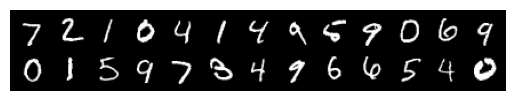

dVAE reconstruction:


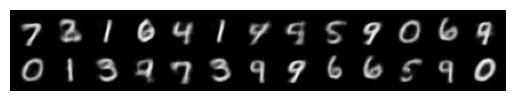

[Temp=0.8] Intra-class distance: 0.9571, Inter-class distance: 0.9696


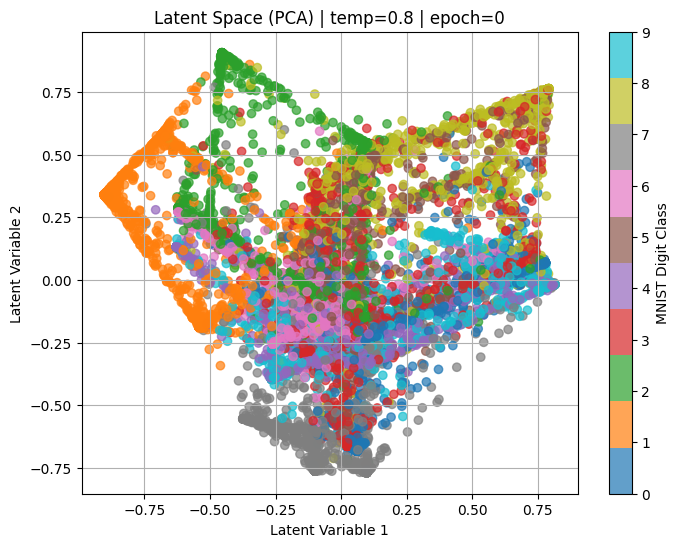

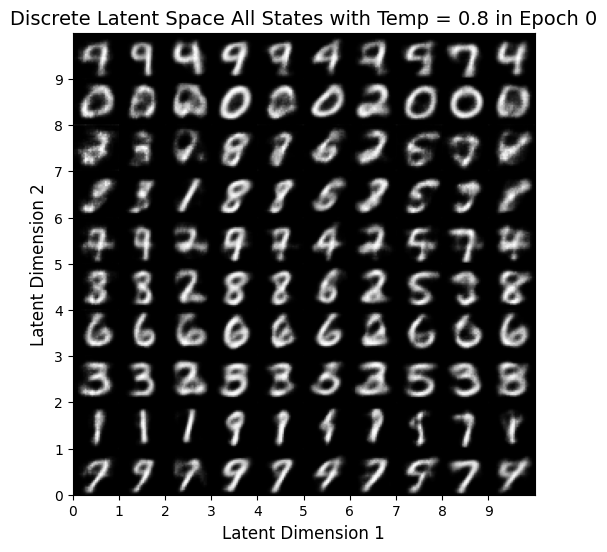

-----> Epoch: 1 Average loss: 146.2068
-----> Epoch: 2 Average loss: 142.3820
-----> Epoch: 3 Average loss: 140.5246
-----> Epoch: 4 Average loss: 139.2771
-----> Epoch: 5 Average loss: 138.2407
[Temp=0.8] Intra-class distance: 0.9758, Inter-class distance: 0.9401


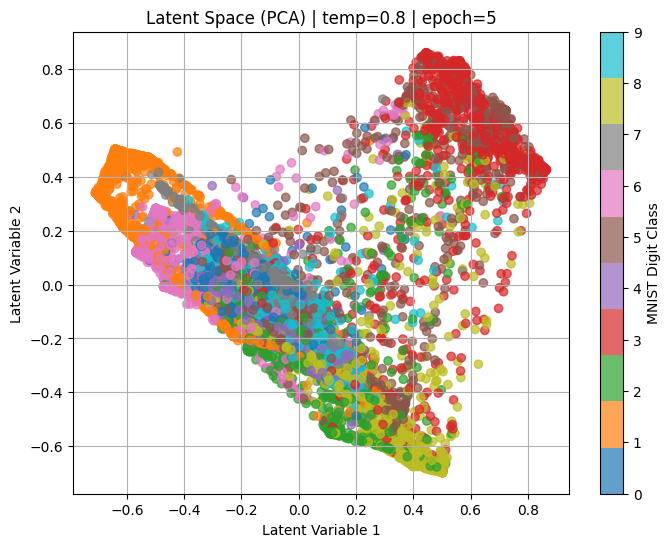

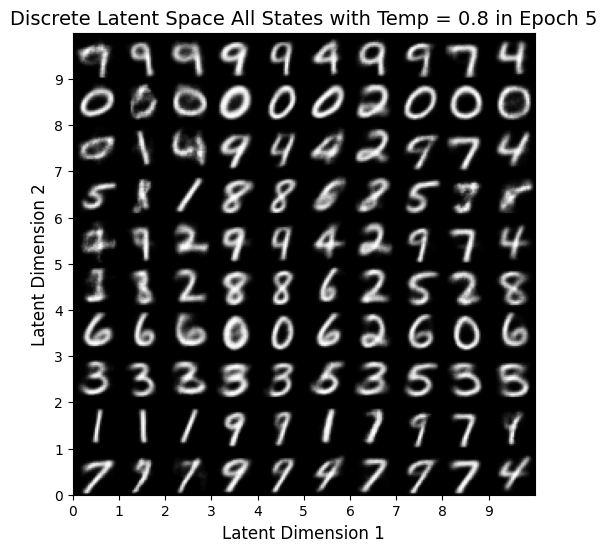

-----> Epoch: 6 Average loss: 137.3118
-----> Epoch: 7 Average loss: 136.6250
-----> Epoch: 8 Average loss: 135.9233
-----> Epoch: 9 Average loss: 135.2252
-----> Epoch: 10 Average loss: 134.5180
Original images:


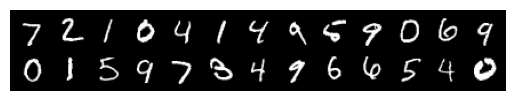

dVAE reconstruction:


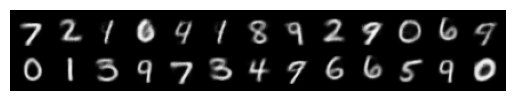

[Temp=0.8] Intra-class distance: 0.9667, Inter-class distance: 0.9207


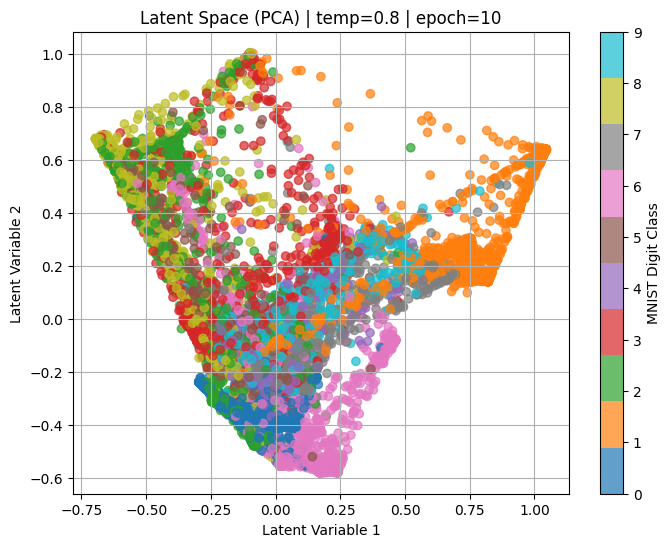

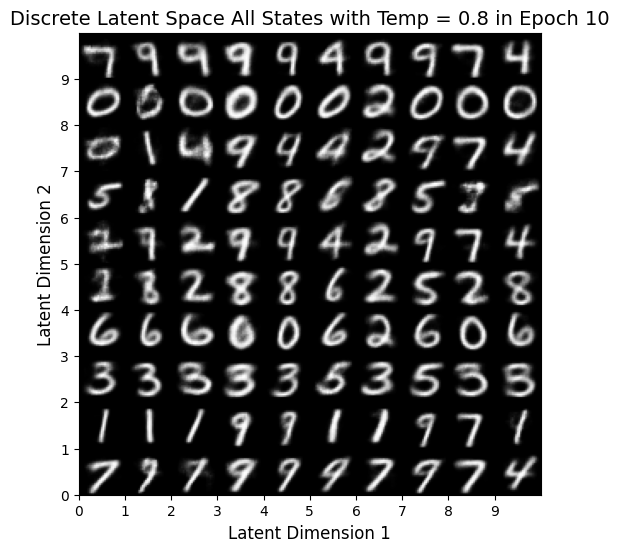

-----> Epoch: 11 Average loss: 134.0312
-----> Epoch: 12 Average loss: 133.5198
-----> Epoch: 13 Average loss: 133.0272
-----> Epoch: 14 Average loss: 132.6436
-----> Epoch: 15 Average loss: 132.2593
[Temp=0.8] Intra-class distance: 0.9603, Inter-class distance: 0.9244


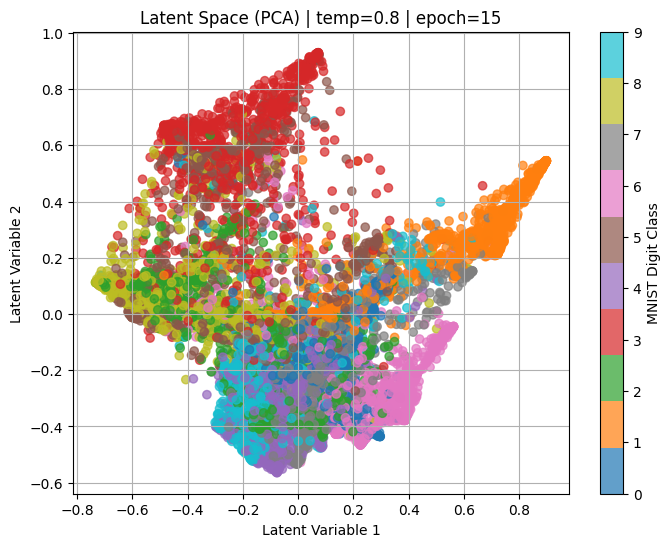

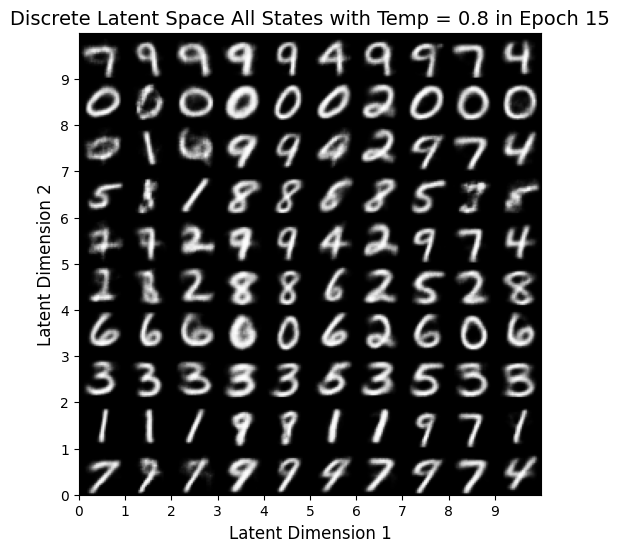

-----> Epoch: 16 Average loss: 131.8322
-----> Epoch: 17 Average loss: 131.5566
-----> Epoch: 18 Average loss: 131.1829
-----> Epoch: 19 Average loss: 130.7267
-----> Epoch: 20 Average loss: 130.4591
Original images:


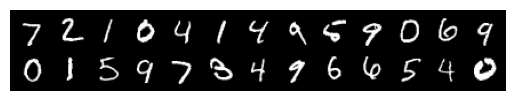

dVAE reconstruction:


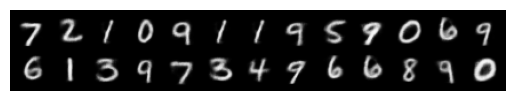

[Temp=0.8] Intra-class distance: 0.9556, Inter-class distance: 0.9083


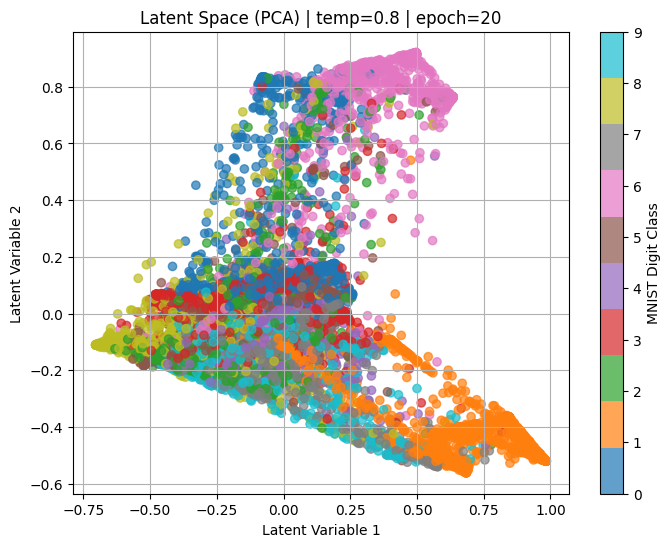

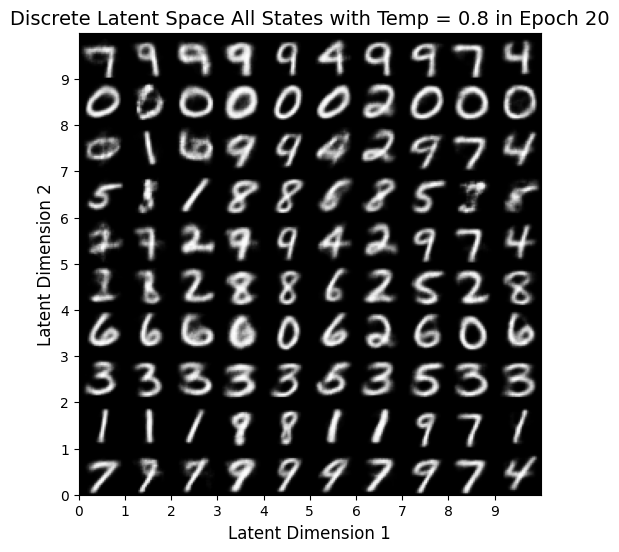

-----> Epoch: 21 Average loss: 130.1993
-----> Epoch: 22 Average loss: 129.9768
-----> Epoch: 23 Average loss: 129.6452
-----> Epoch: 24 Average loss: 129.4077
-----> Epoch: 25 Average loss: 129.2614
[Temp=0.8] Intra-class distance: 0.9514, Inter-class distance: 0.8982


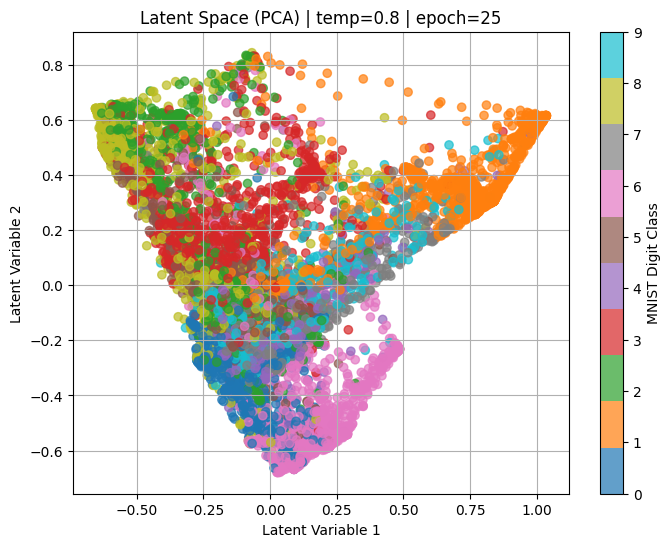

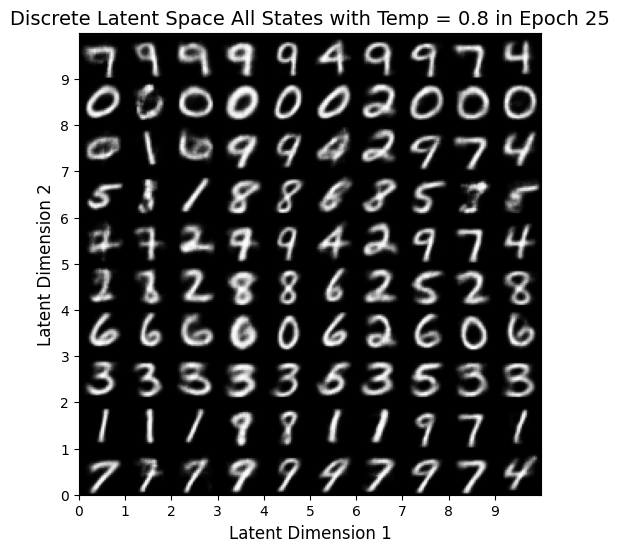

-----> Epoch: 26 Average loss: 128.8563
-----> Epoch: 27 Average loss: 128.7863
-----> Epoch: 28 Average loss: 128.6373
-----> Epoch: 29 Average loss: 128.3758
-----> Epoch: 30 Average loss: 128.2510
Original images:


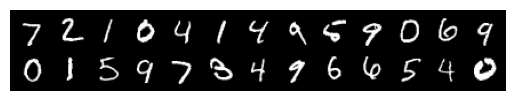

dVAE reconstruction:


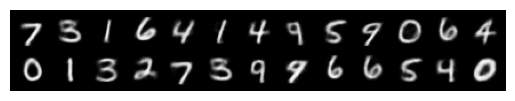

[Temp=0.8] Intra-class distance: 0.9528, Inter-class distance: 0.9020


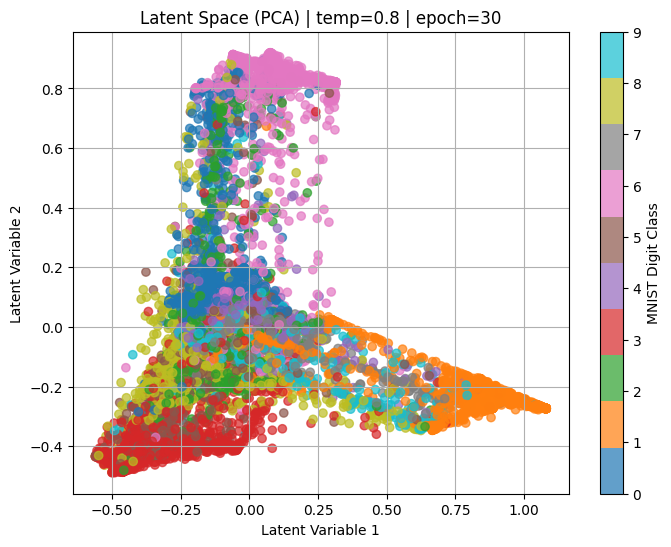

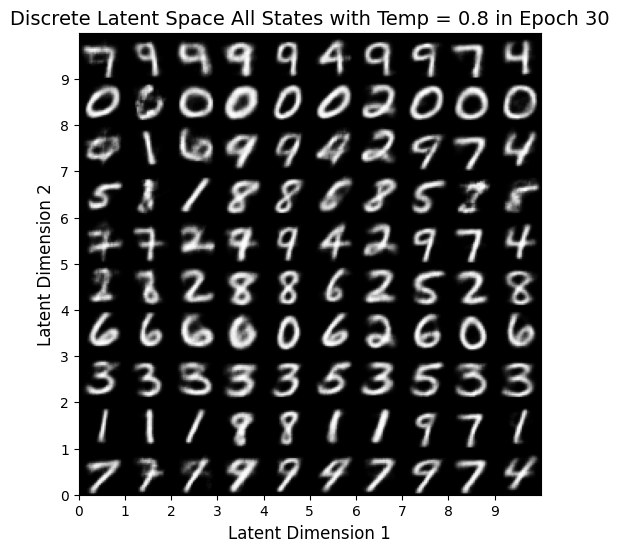

-----> Epoch: 31 Average loss: 127.9817
-----> Epoch: 32 Average loss: 127.8861
-----> Epoch: 33 Average loss: 127.7248
-----> Epoch: 34 Average loss: 127.6471
-----> Epoch: 35 Average loss: 127.4446
[Temp=0.8] Intra-class distance: 0.9520, Inter-class distance: 0.8841


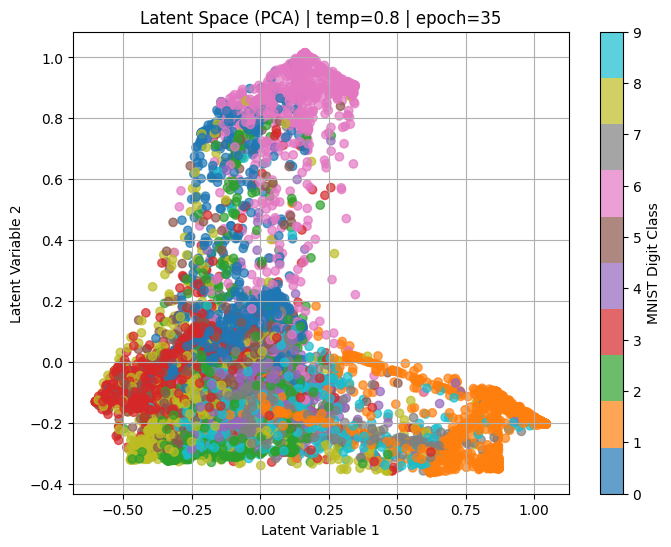

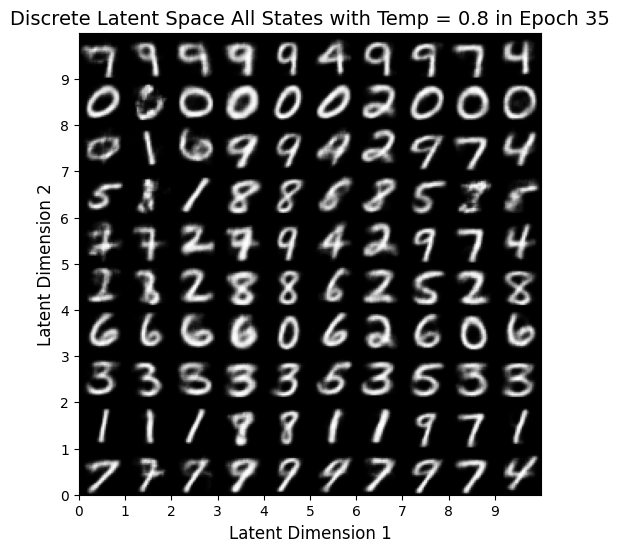

-----> Epoch: 36 Average loss: 127.3987
-----> Epoch: 37 Average loss: 127.2025
-----> Epoch: 38 Average loss: 127.1678
-----> Epoch: 39 Average loss: 126.9365
-----> Epoch: 40 Average loss: 126.7534
Original images:


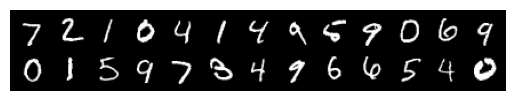

dVAE reconstruction:


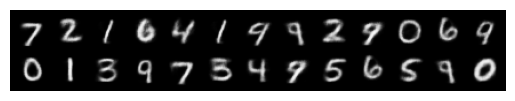

[Temp=0.8] Intra-class distance: 0.9529, Inter-class distance: 0.8852


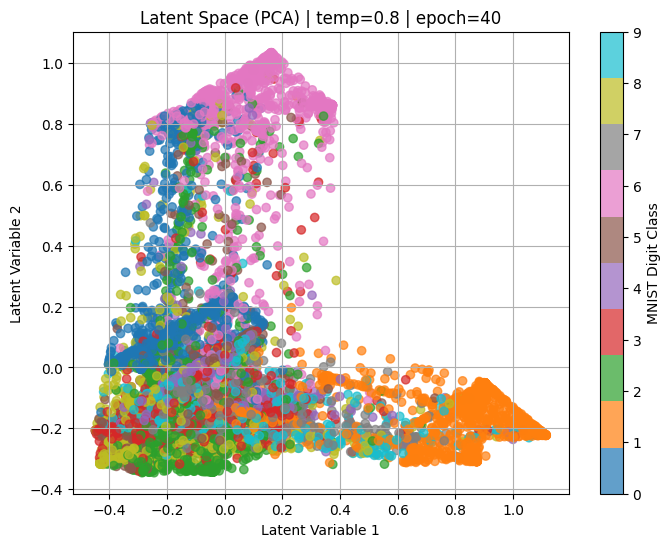

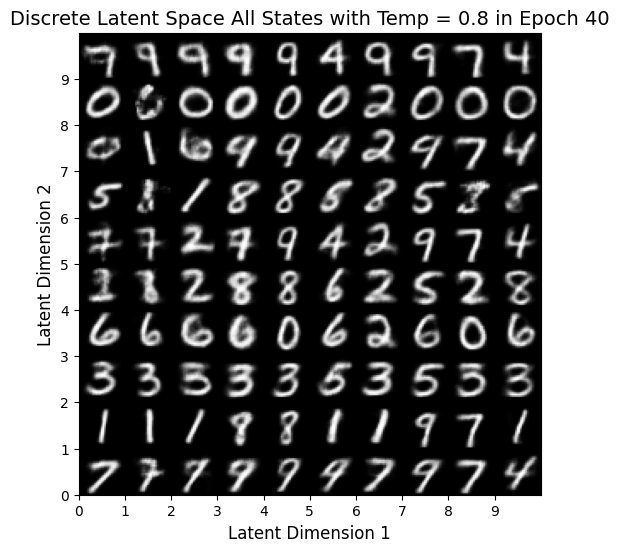

-----> Epoch: 41 Average loss: 126.7099
-----> Epoch: 42 Average loss: 126.5927
-----> Epoch: 43 Average loss: 126.3387
-----> Epoch: 44 Average loss: 126.4089
-----> Epoch: 45 Average loss: 126.1711
[Temp=0.8] Intra-class distance: 0.9480, Inter-class distance: 0.8902


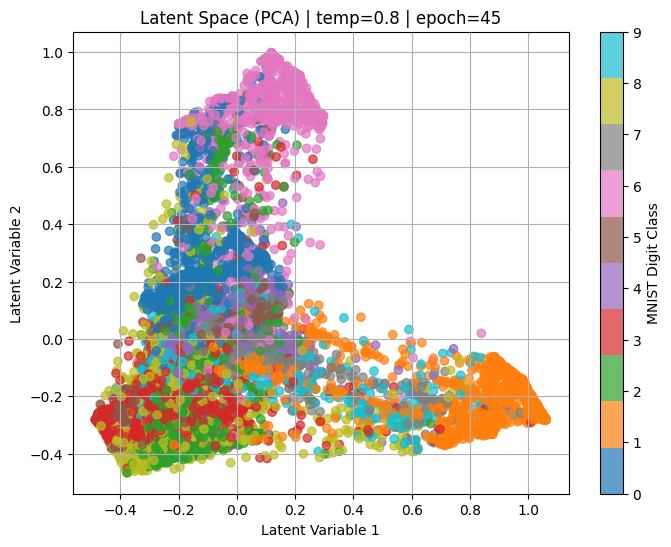

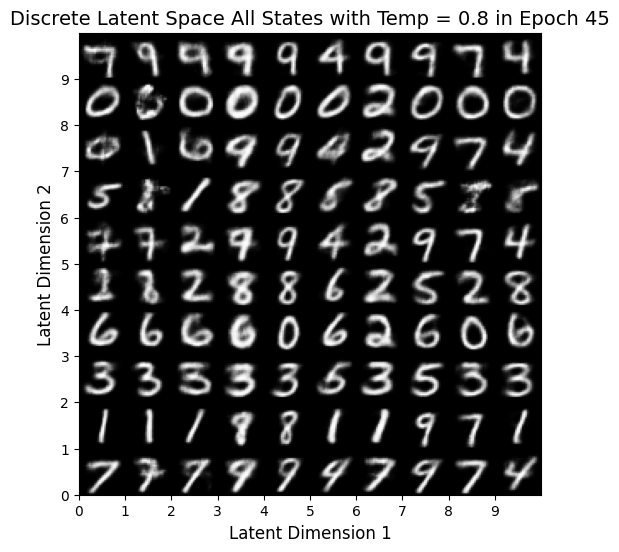

-----> Epoch: 46 Average loss: 126.1534
-----> Epoch: 47 Average loss: 126.0495
-----> Epoch: 48 Average loss: 125.9784
-----> Epoch: 49 Average loss: 125.9042
-----> Epoch: 50 Average loss: 125.8036
Original images:


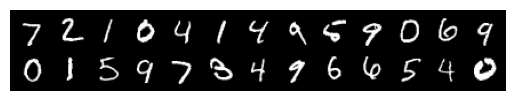

dVAE reconstruction:


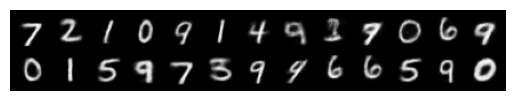

[Temp=0.8] Intra-class distance: 0.9551, Inter-class distance: 0.8937


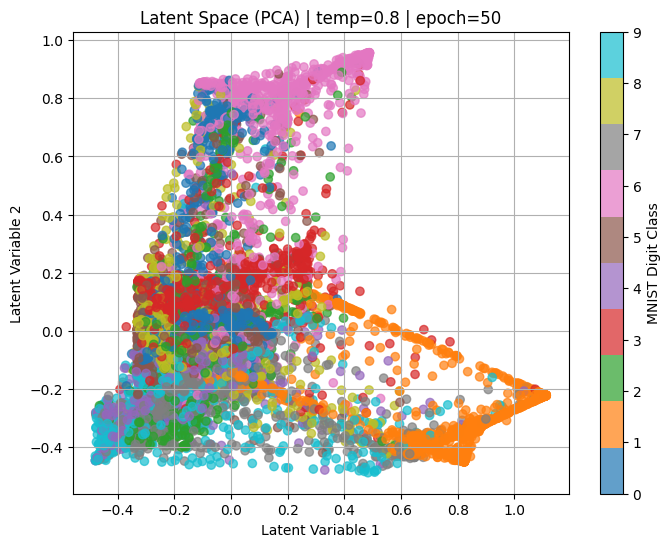

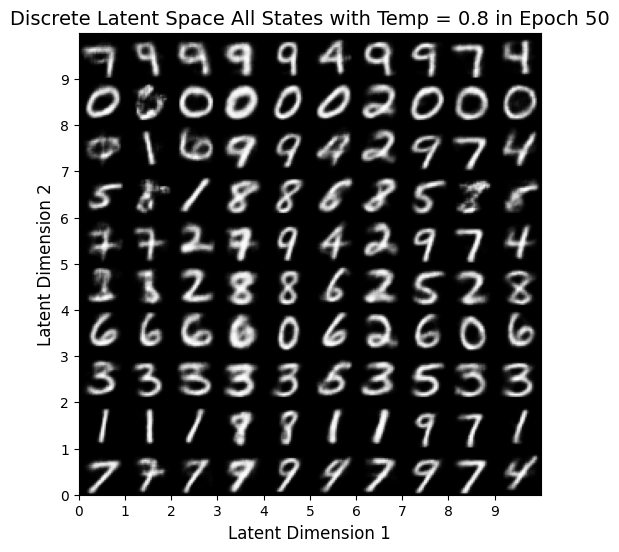

-----> Epoch: 51 Average loss: 125.7380
-----> Epoch: 52 Average loss: 125.5025
-----> Epoch: 53 Average loss: 125.4636
-----> Epoch: 54 Average loss: 125.4144
-----> Epoch: 55 Average loss: 125.2810
[Temp=0.8] Intra-class distance: 0.9500, Inter-class distance: 0.8752


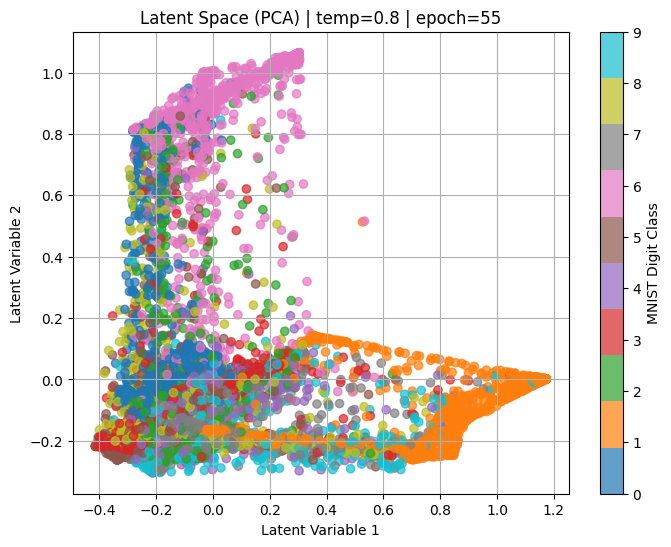

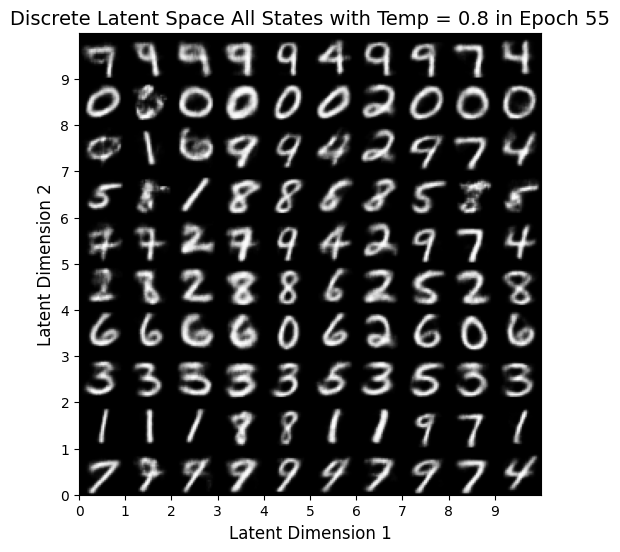

-----> Epoch: 56 Average loss: 125.1934
-----> Epoch: 57 Average loss: 125.1773
-----> Epoch: 58 Average loss: 125.0945
-----> Epoch: 59 Average loss: 124.9045
-----> Epoch: 60 Average loss: 124.9630
Original images:


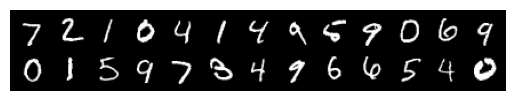

dVAE reconstruction:


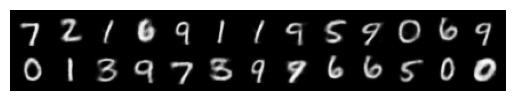

[Temp=0.8] Intra-class distance: 0.9543, Inter-class distance: 0.8790


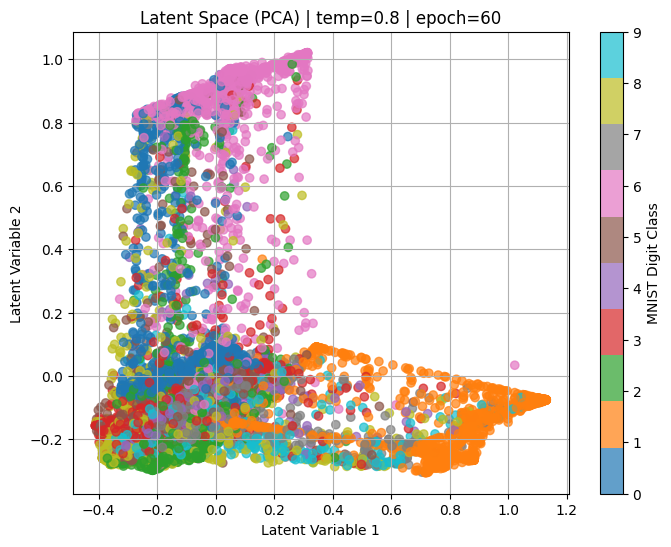

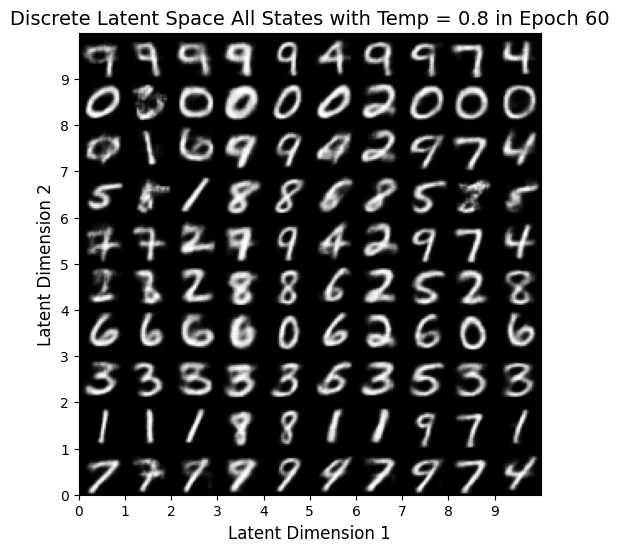

-----> Epoch: 61 Average loss: 124.9252
-----> Epoch: 62 Average loss: 124.8419
-----> Epoch: 63 Average loss: 124.7934
-----> Epoch: 64 Average loss: 124.7167
-----> Epoch: 65 Average loss: 124.5679
[Temp=0.8] Intra-class distance: 0.9526, Inter-class distance: 0.8881


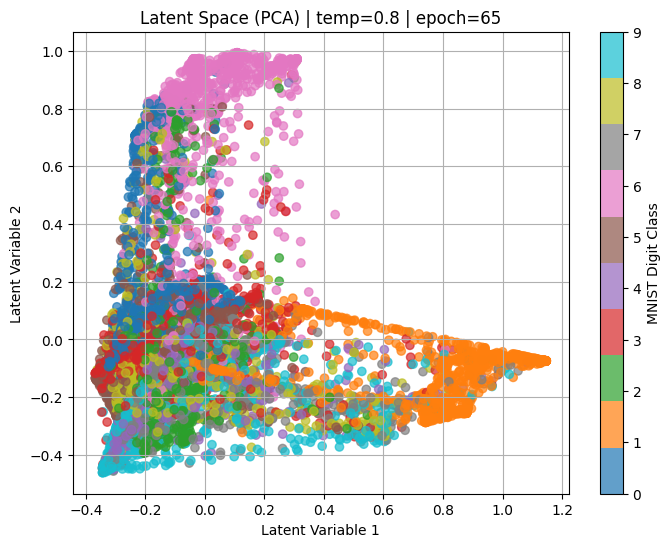

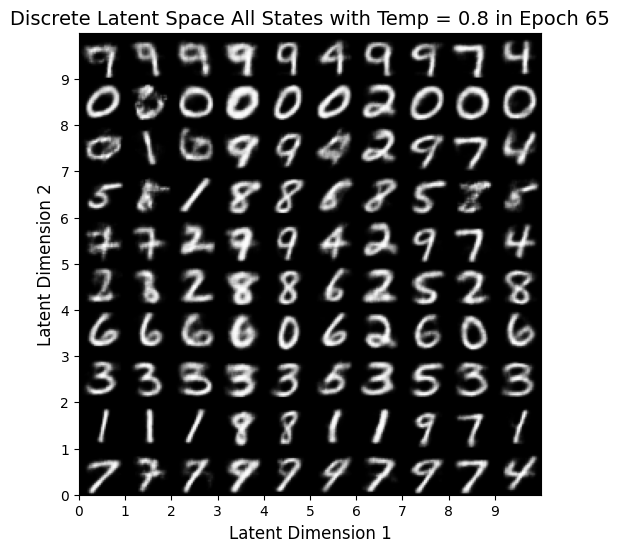

-----> Epoch: 66 Average loss: 124.5897
-----> Epoch: 67 Average loss: 124.4088
-----> Epoch: 68 Average loss: 124.5553
-----> Epoch: 69 Average loss: 124.4072
-----> Epoch: 70 Average loss: 124.3121
Original images:


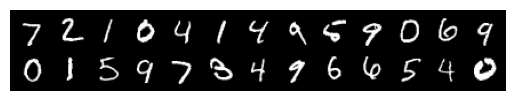

dVAE reconstruction:


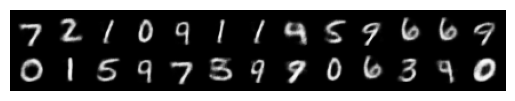

[Temp=0.8] Intra-class distance: 0.9434, Inter-class distance: 0.8817


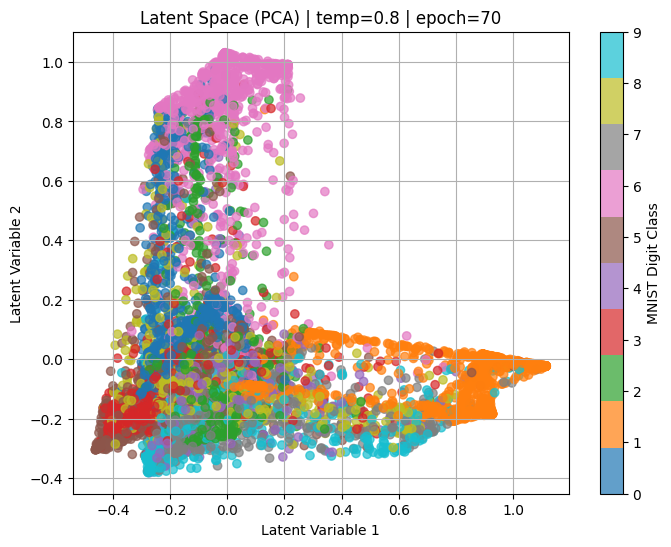

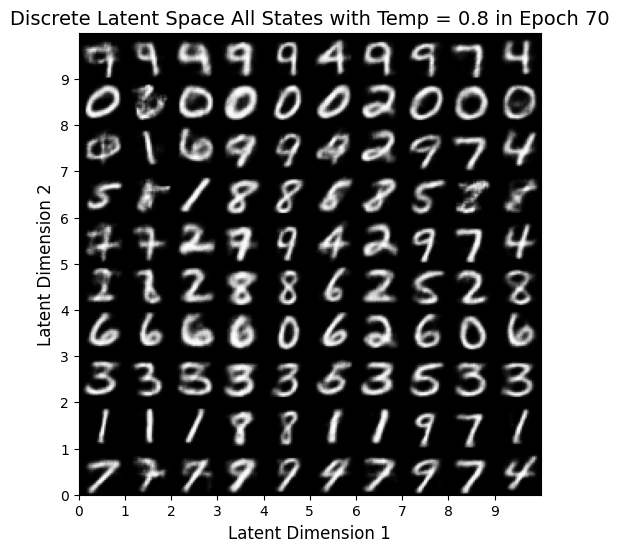

In [ ]:
dVAE_0_8,test_loader,train_loss_avg = dVAE_Train(0.8,71,38)

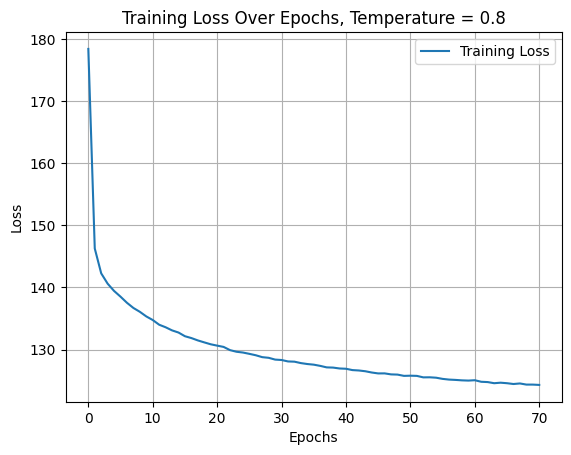

In [ ]:
import matplotlib.pyplot as plt
plt.ion()

fig = plt.figure()
plt.plot(train_loss_avg, label='Training Loss')  # Added a label for clarity
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs, Temperature = 0.8')  # Added a title
plt.grid(True)  # Enabled the grid
plt.legend()  # Added a legend
plt.show()

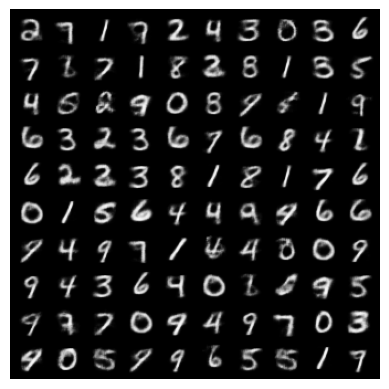

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils

# Function to visualize sampled images from dVAE's discrete latent space
def sample_from_dVAE(dVAE, latent_dim, categorical_dim, device, temp=0.8, num_samples=10):
    dVAE.eval()  # Set model to evaluation mode
    with torch.no_grad():
        # Sample from a uniform categorical distribution (one-hot encoded)
        logits = torch.full((num_samples, latent_dim, categorical_dim), 1.0, device=device)  # Uniform logits
        latent_z = torch.distributions.OneHotCategorical(logits=logits).sample()  # Sample one-hot vectors

        # Flatten categorical latent representation
        latent_z = latent_z.view(num_samples, latent_dim * categorical_dim)



        # Decode images from sampled latent vectors
        img_recon = dVAE.decode(latent_z)
        img_recon = img_recon.cpu()

        # Show reconstructed images
        grid_img = vutils.make_grid(img_recon[:num_samples], nrow=10, padding=5)
        show_image(grid_img)
        plt.show()

# Call function to sample from dVAE
sample_from_dVAE(dVAE_0_8, latent_dim=2, categorical_dim=10, device=device, temp=0.8, num_samples=100)


## **Testing different Temperatrue Values**

### **$\lambda = 0.05:$**

-----> Epoch: 0 Average loss: 206.1783
Original images:


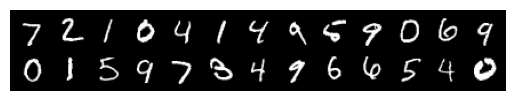

dVAE reconstruction:


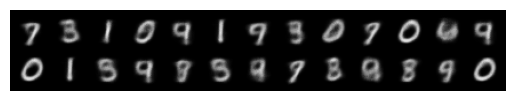

[Temp=0.05] Intra-class distance: 1.1716, Inter-class distance: 0.8248


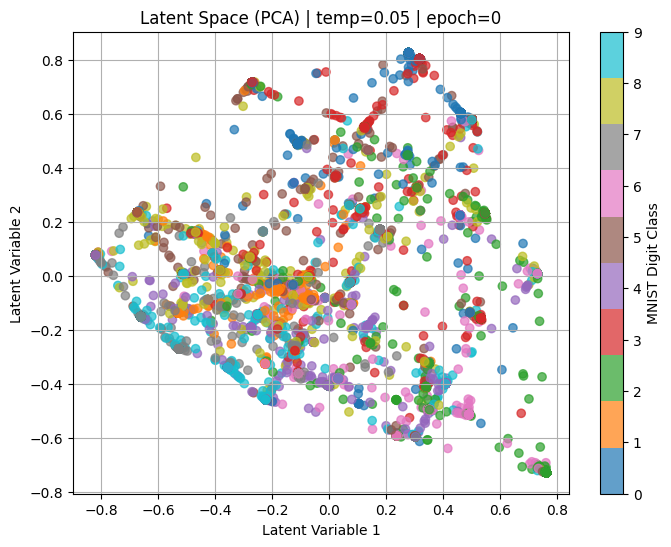

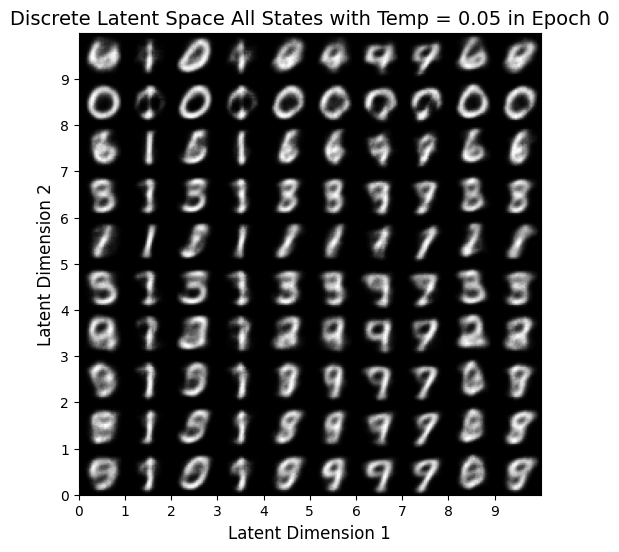

-----> Epoch: 1 Average loss: 178.7722
-----> Epoch: 2 Average loss: 175.3274
-----> Epoch: 3 Average loss: 173.5941
-----> Epoch: 4 Average loss: 172.6922
-----> Epoch: 5 Average loss: 171.7833
[Temp=0.05] Intra-class distance: 1.1434, Inter-class distance: 0.9477


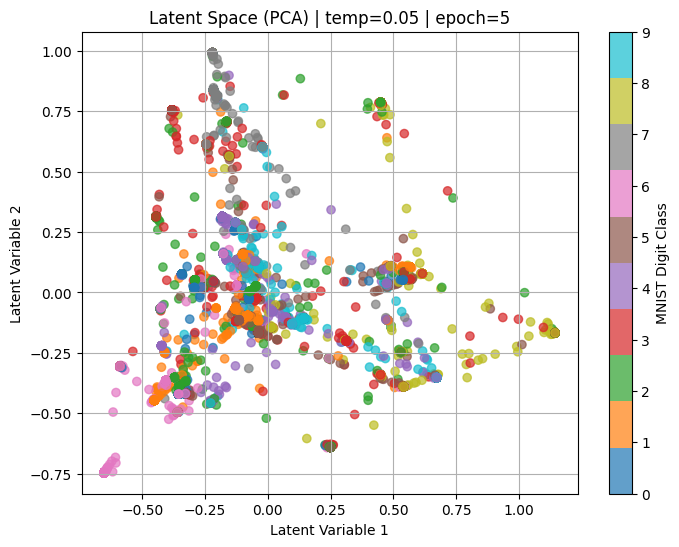

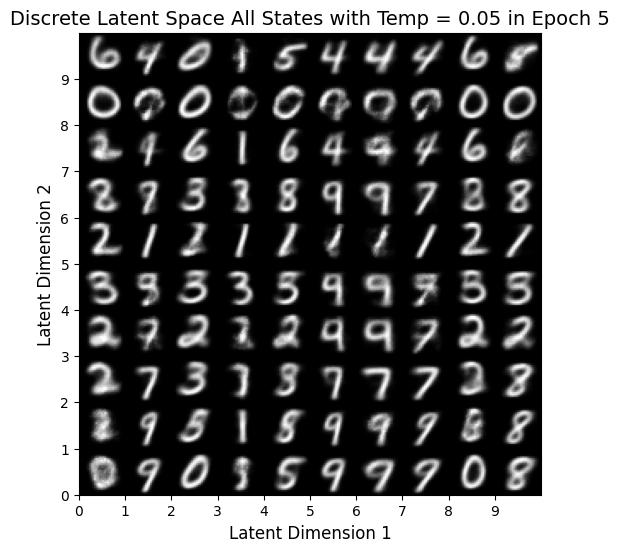

-----> Epoch: 6 Average loss: 171.1534
-----> Epoch: 7 Average loss: 170.7363
-----> Epoch: 8 Average loss: 170.2997
-----> Epoch: 9 Average loss: 170.1746
-----> Epoch: 10 Average loss: 170.2327
Original images:


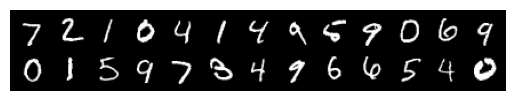

dVAE reconstruction:


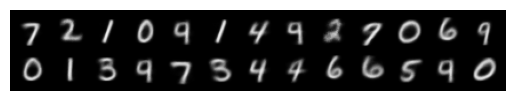

[Temp=0.05] Intra-class distance: 1.1497, Inter-class distance: 0.9423


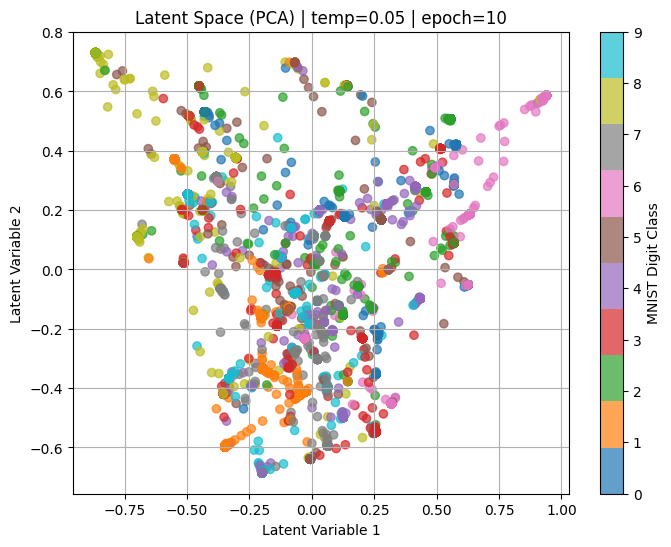

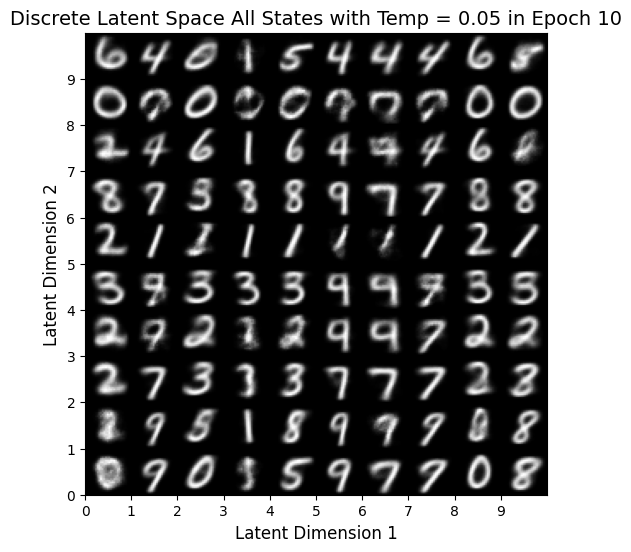

-----> Epoch: 11 Average loss: 169.7096
-----> Epoch: 12 Average loss: 169.7679
-----> Epoch: 13 Average loss: 169.6819
-----> Epoch: 14 Average loss: 169.6561
-----> Epoch: 15 Average loss: 169.4398
[Temp=0.05] Intra-class distance: 1.1503, Inter-class distance: 0.9423


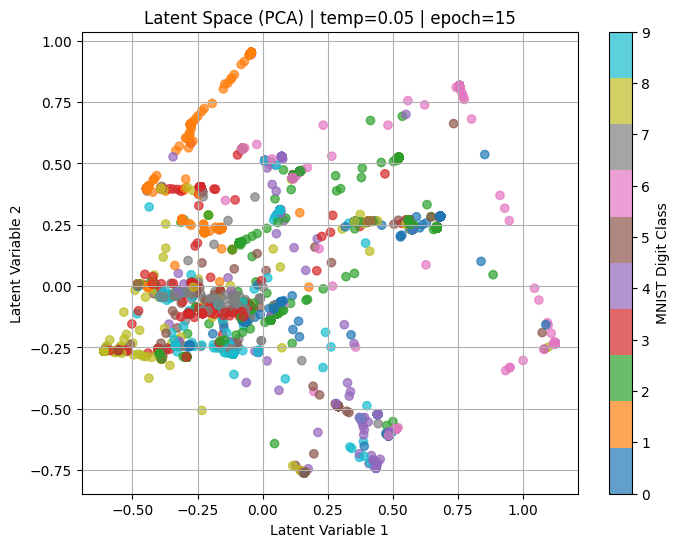

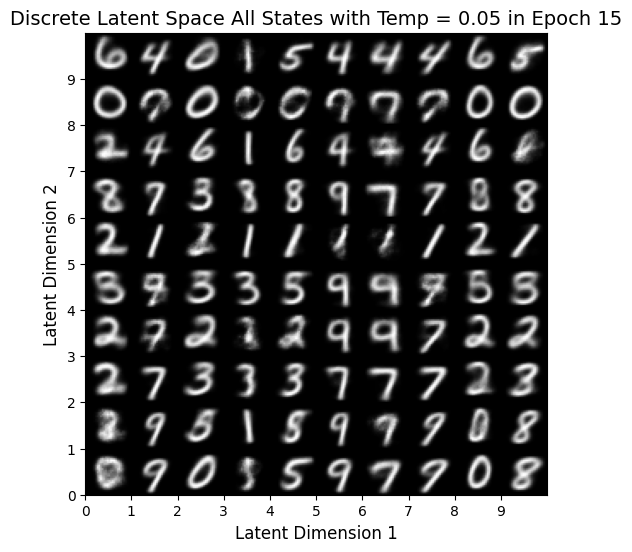

-----> Epoch: 16 Average loss: 169.5505
-----> Epoch: 17 Average loss: 169.1657
-----> Epoch: 18 Average loss: 169.2779
-----> Epoch: 19 Average loss: 169.0936
-----> Epoch: 20 Average loss: 168.9117
Original images:


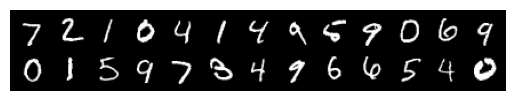

dVAE reconstruction:


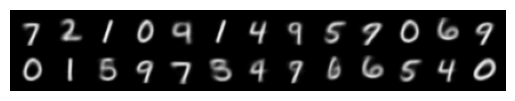

[Temp=0.05] Intra-class distance: 1.1477, Inter-class distance: 0.9489


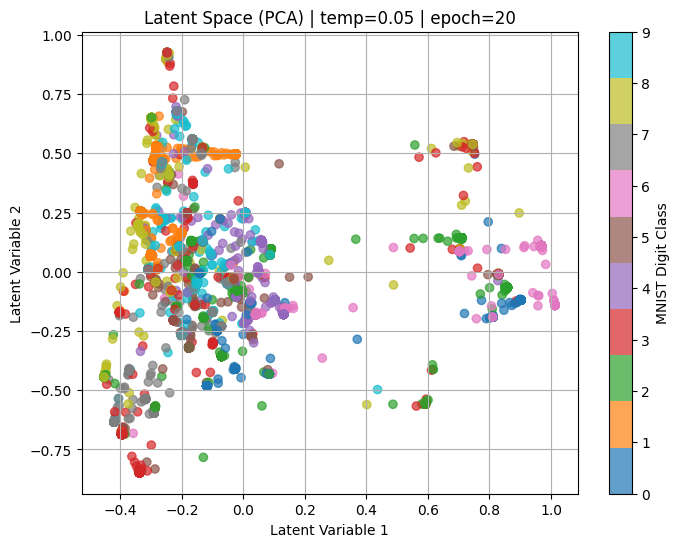

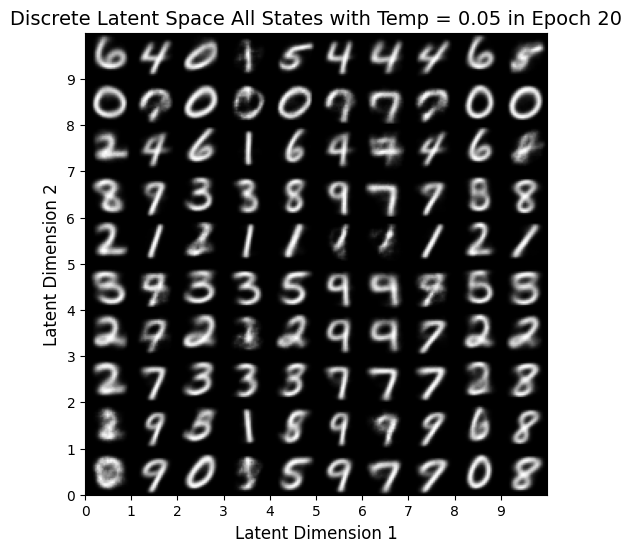

-----> Epoch: 21 Average loss: 168.9085
-----> Epoch: 22 Average loss: 168.8960
-----> Epoch: 23 Average loss: 168.7211
-----> Epoch: 24 Average loss: 168.7584
-----> Epoch: 25 Average loss: 168.6999
[Temp=0.05] Intra-class distance: 1.1424, Inter-class distance: 0.9578


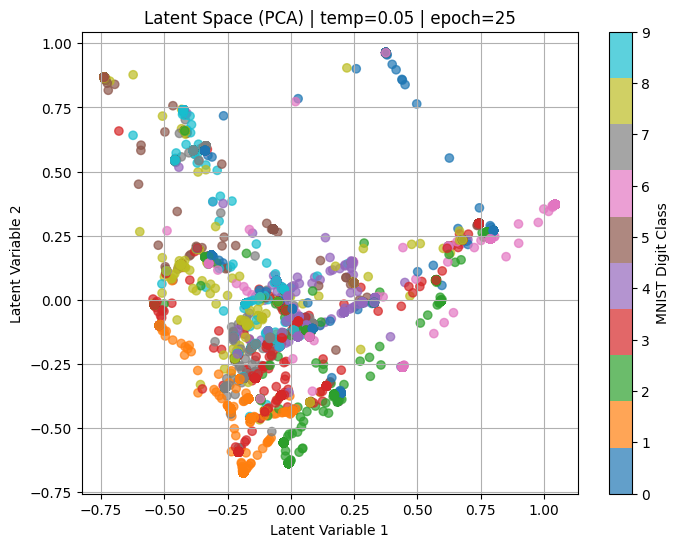

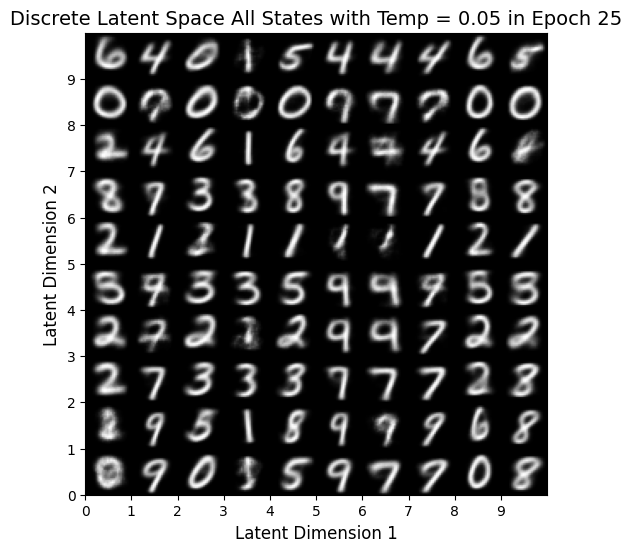

-----> Epoch: 26 Average loss: 168.5242
-----> Epoch: 27 Average loss: 168.4345
-----> Epoch: 28 Average loss: 168.3971
-----> Epoch: 29 Average loss: 168.4994
-----> Epoch: 30 Average loss: 168.4437
Original images:


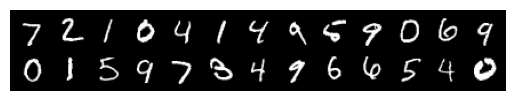

dVAE reconstruction:


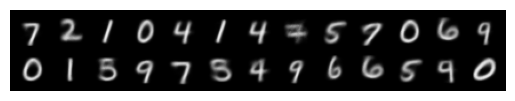

[Temp=0.05] Intra-class distance: 1.1598, Inter-class distance: 0.9042


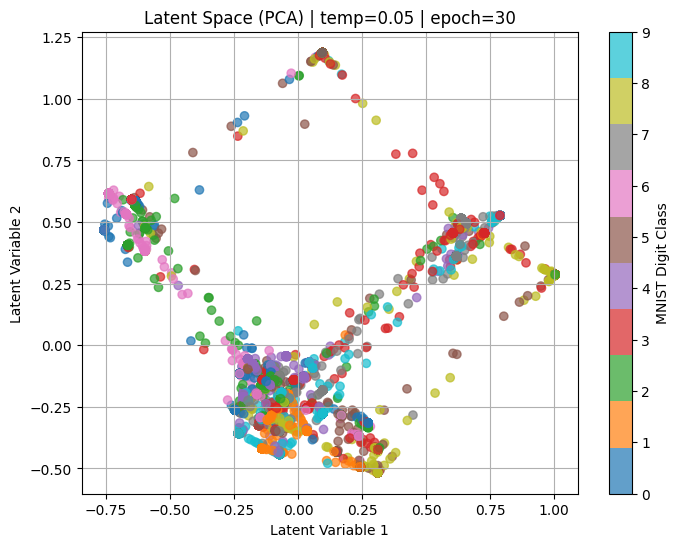

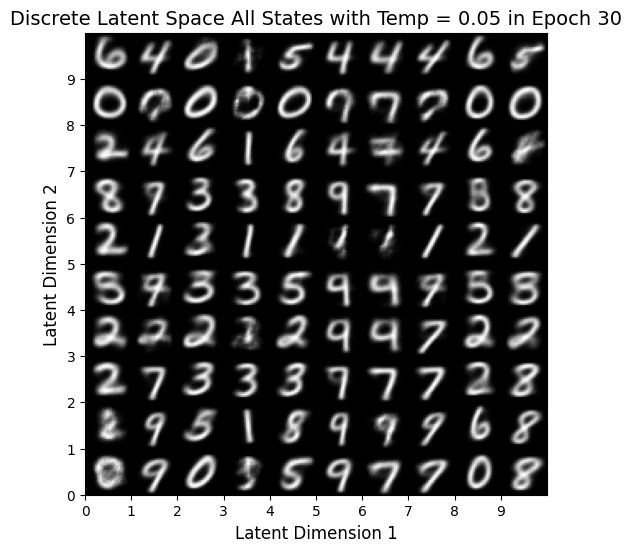

-----> Epoch: 31 Average loss: 168.6096
-----> Epoch: 32 Average loss: 168.1661
-----> Epoch: 33 Average loss: 168.1468
-----> Epoch: 34 Average loss: 168.1974
-----> Epoch: 35 Average loss: 168.0751
[Temp=0.05] Intra-class distance: 1.1522, Inter-class distance: 0.9453


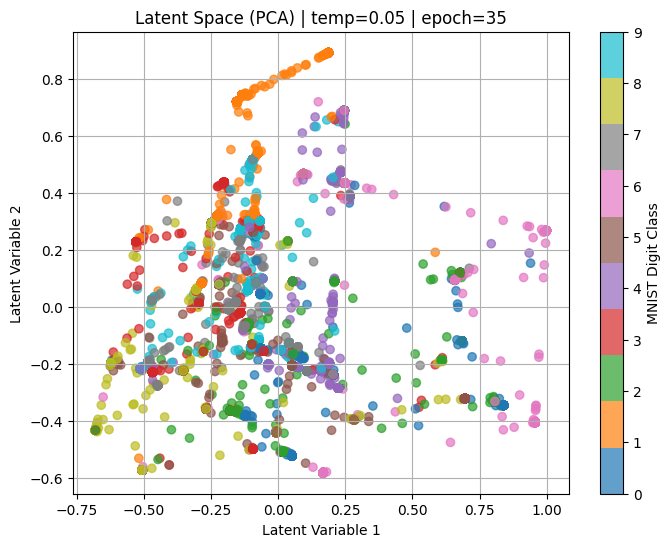

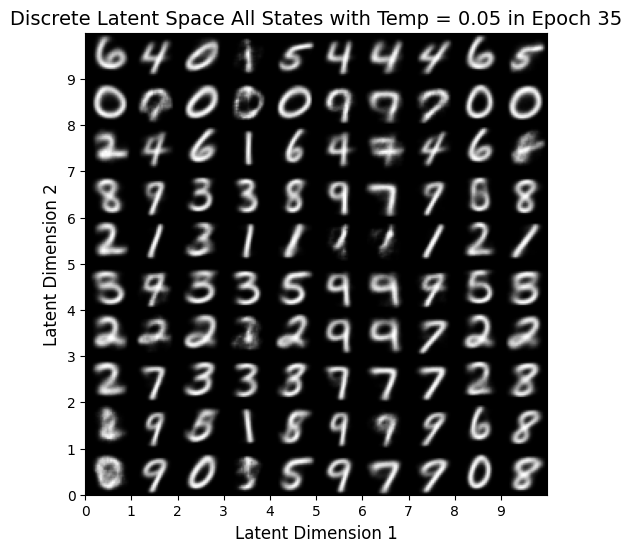

-----> Epoch: 36 Average loss: 167.9823
-----> Epoch: 37 Average loss: 168.0376
-----> Epoch: 38 Average loss: 167.9541
-----> Epoch: 39 Average loss: 167.7249
-----> Epoch: 40 Average loss: 167.9591
Original images:


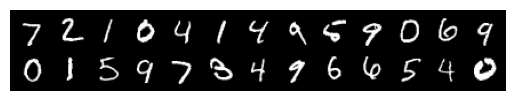

dVAE reconstruction:


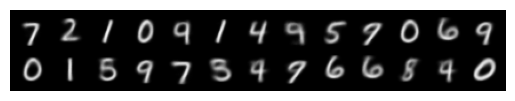

[Temp=0.05] Intra-class distance: 1.1576, Inter-class distance: 0.9289


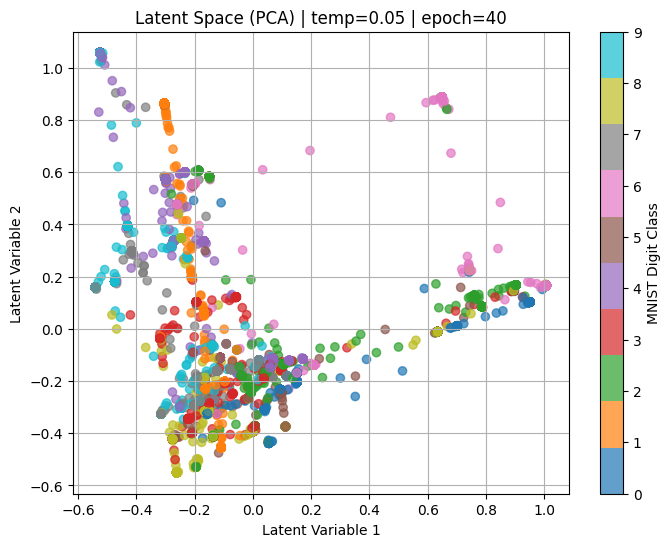

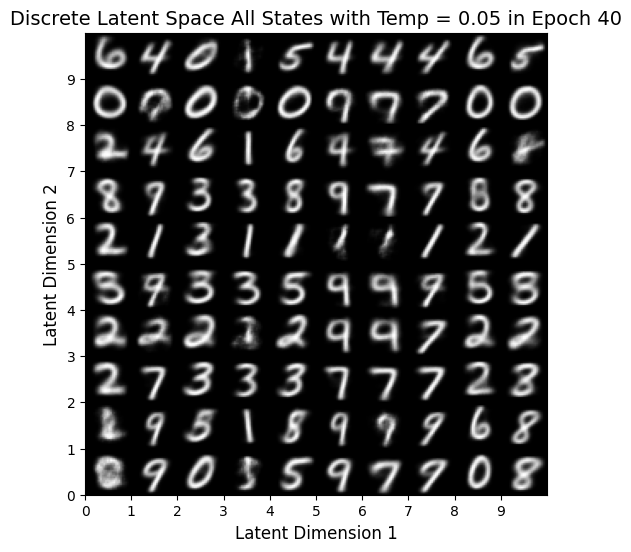

-----> Epoch: 41 Average loss: 167.8567
-----> Epoch: 42 Average loss: 167.6857
-----> Epoch: 43 Average loss: 167.7010
-----> Epoch: 44 Average loss: 167.8448
-----> Epoch: 45 Average loss: 167.6413
[Temp=0.05] Intra-class distance: 1.1539, Inter-class distance: 0.9321


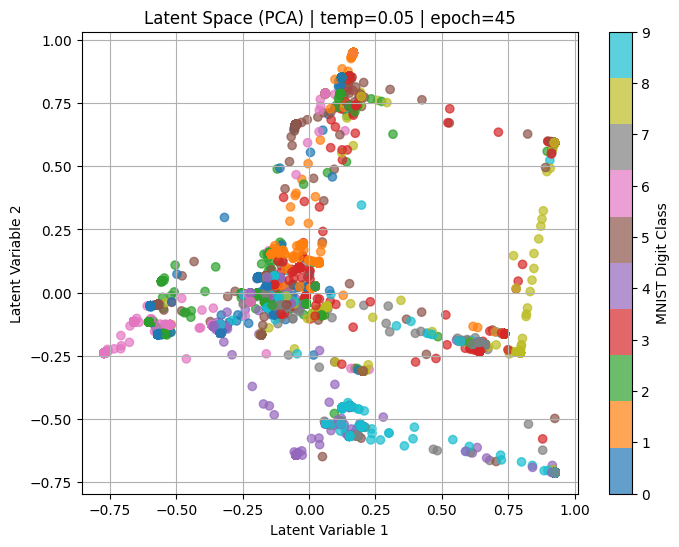

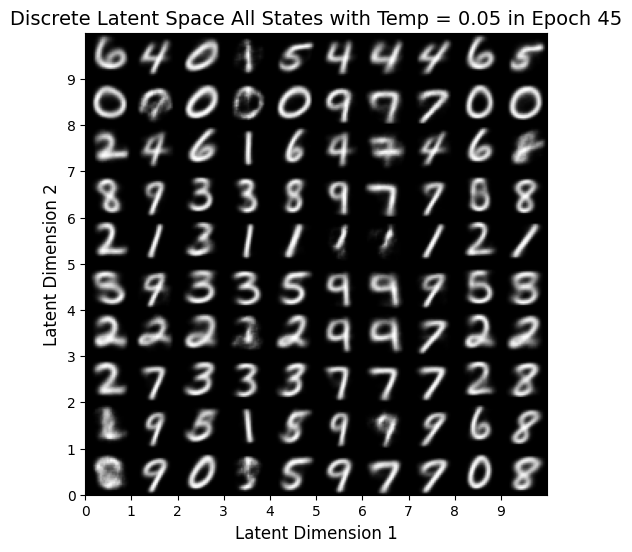

-----> Epoch: 46 Average loss: 167.6815
-----> Epoch: 47 Average loss: 167.5799
-----> Epoch: 48 Average loss: 167.5371
-----> Epoch: 49 Average loss: 167.5397
-----> Epoch: 50 Average loss: 167.3432
Original images:


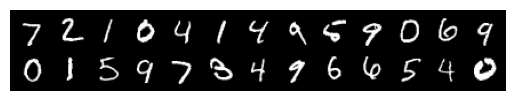

dVAE reconstruction:


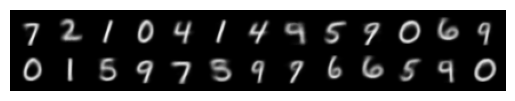

[Temp=0.05] Intra-class distance: 1.1489, Inter-class distance: 0.9492


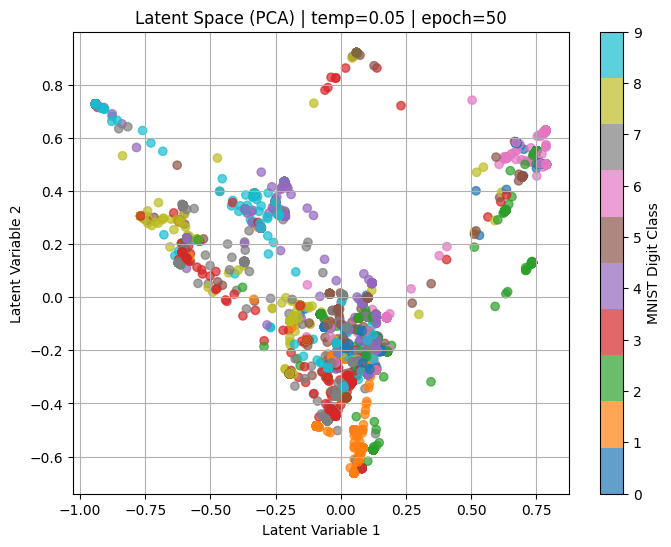

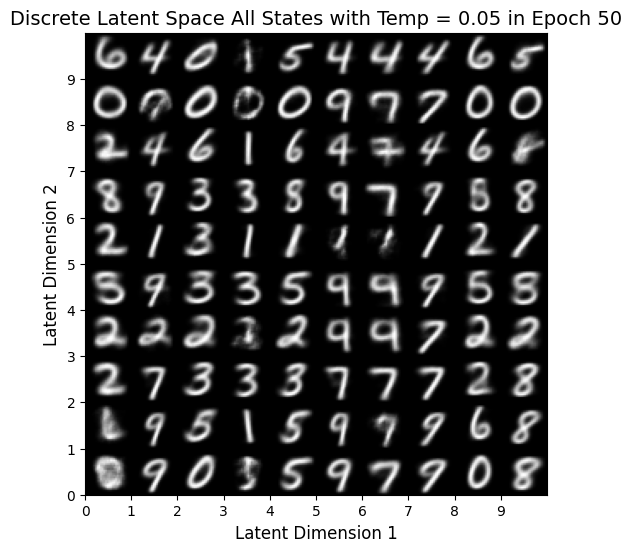

-----> Epoch: 51 Average loss: 167.3769
-----> Epoch: 52 Average loss: 167.4138
-----> Epoch: 53 Average loss: 167.4045
-----> Epoch: 54 Average loss: 167.3728
-----> Epoch: 55 Average loss: 167.4410
[Temp=0.05] Intra-class distance: 1.1545, Inter-class distance: 0.9337


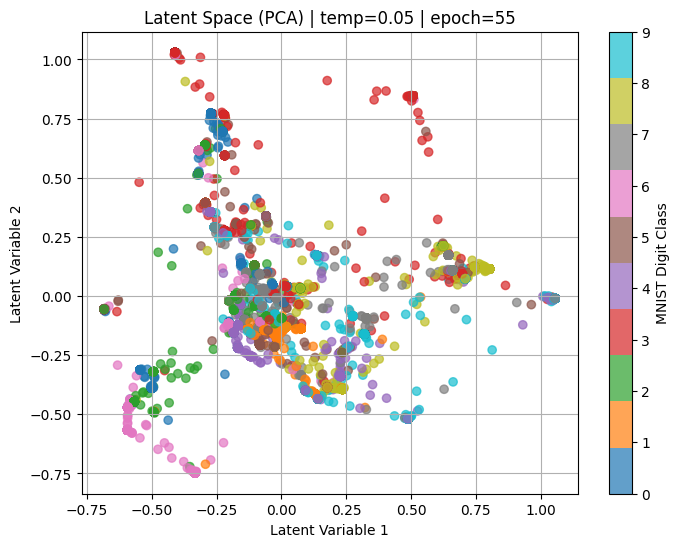

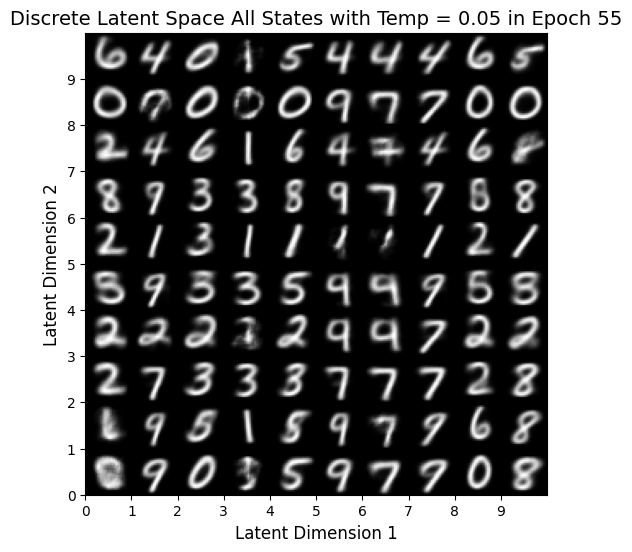

-----> Epoch: 56 Average loss: 167.2552
-----> Epoch: 57 Average loss: 167.2917
-----> Epoch: 58 Average loss: 167.3273
-----> Epoch: 59 Average loss: 167.3669
-----> Epoch: 60 Average loss: 167.3292
Original images:


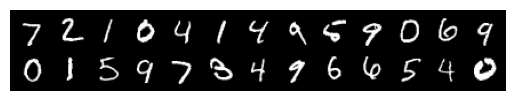

dVAE reconstruction:


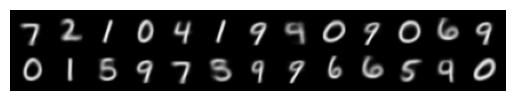

[Temp=0.05] Intra-class distance: 1.1590, Inter-class distance: 0.9317


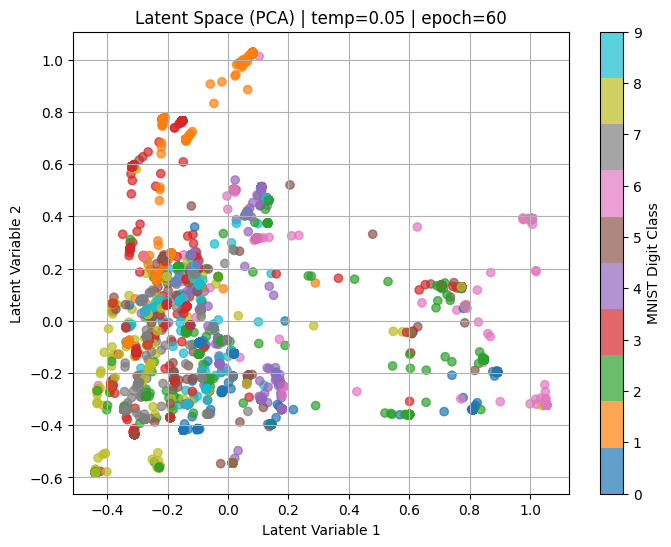

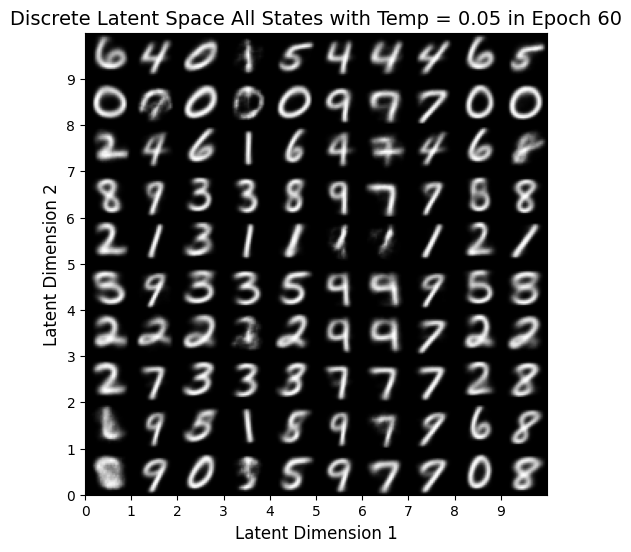

-----> Epoch: 61 Average loss: 167.1315
-----> Epoch: 62 Average loss: 167.1851
-----> Epoch: 63 Average loss: 167.2160
-----> Epoch: 64 Average loss: 166.9889
-----> Epoch: 65 Average loss: 167.1593
[Temp=0.05] Intra-class distance: 1.1630, Inter-class distance: 0.9137


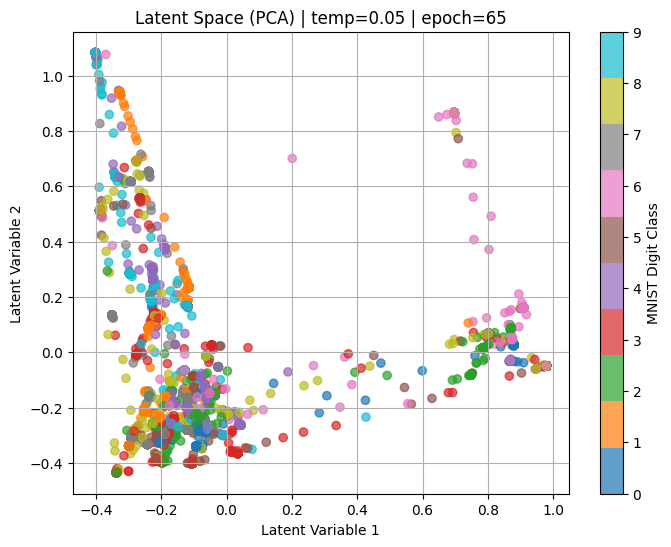

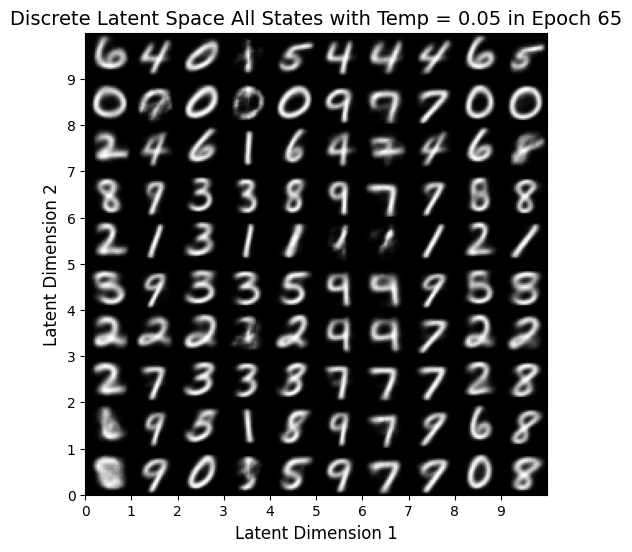

-----> Epoch: 66 Average loss: 167.2315
-----> Epoch: 67 Average loss: 167.1563
-----> Epoch: 68 Average loss: 167.0730
-----> Epoch: 69 Average loss: 167.0377
-----> Epoch: 70 Average loss: 167.0705
Original images:


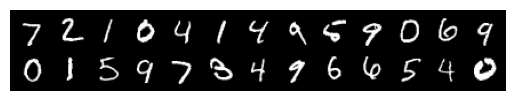

dVAE reconstruction:


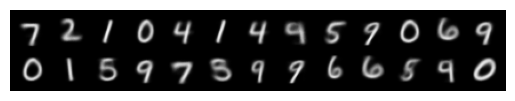

[Temp=0.05] Intra-class distance: 1.1617, Inter-class distance: 0.9239


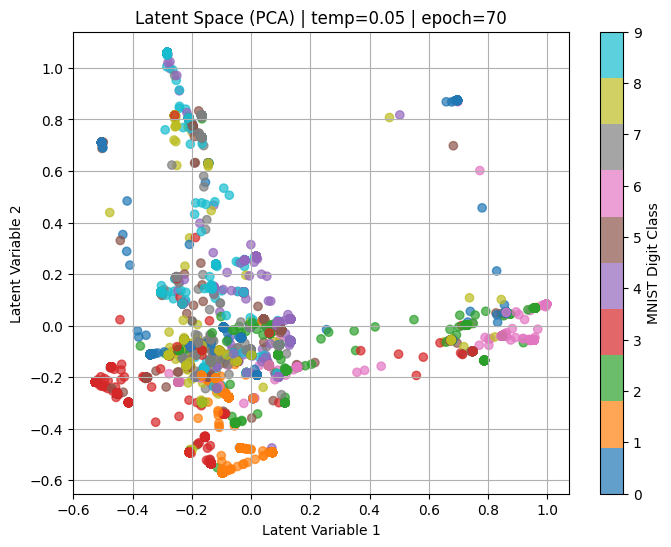

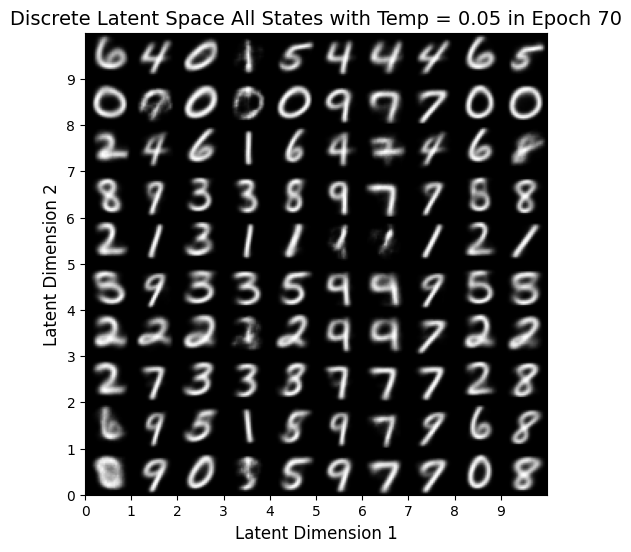

In [ ]:
dVAE_0_0_5,test_loader,train_loss_avg = dVAE_Train(0.05,71,38)

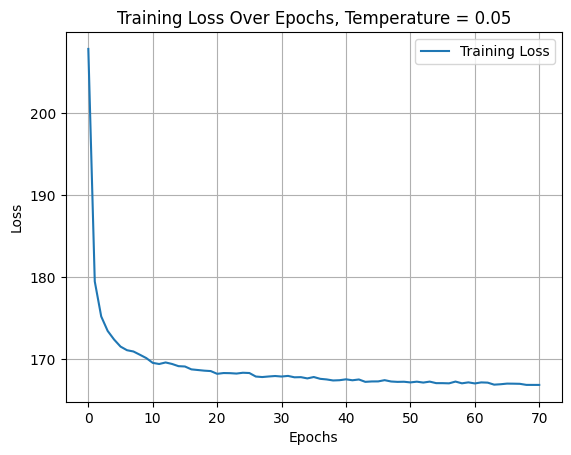

In [ ]:
import matplotlib.pyplot as plt
plt.ion()

fig = plt.figure()
plt.plot(train_loss_avg, label='Training Loss')  # Added a label for clarity
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs, Temperature = 0.05') # Added a title
plt.grid(True)  # Enabled the grid
plt.legend()  # Added a legend
plt.show()

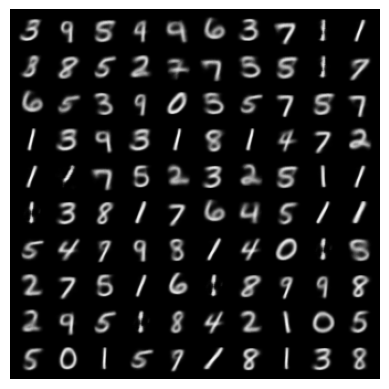

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils

# Function to visualize sampled images from dVAE's discrete latent space
def sample_from_dVAE(dVAE, latent_dim, categorical_dim, device, temp=0.8, num_samples=10):
    dVAE.eval()  # Set model to evaluation mode
    with torch.no_grad():
        # Sample from a uniform categorical distribution (one-hot encoded)
        logits = torch.full((num_samples, latent_dim, categorical_dim), 1.0, device=device)  # Uniform logits
        latent_z = torch.distributions.OneHotCategorical(logits=logits).sample()  # Sample one-hot vectors

        # Flatten categorical latent representation
        latent_z = latent_z.view(num_samples, latent_dim * categorical_dim)



        # Decode images from sampled latent vectors
        img_recon = dVAE.decode(latent_z)
        img_recon = img_recon.cpu()

        # Show reconstructed images
        grid_img = vutils.make_grid(img_recon[:num_samples], nrow=10, padding=5)
        show_image(grid_img)
        plt.show()

# Call function to sample from dVAE
sample_from_dVAE(dVAE_0_0_5, latent_dim=2, categorical_dim=10, device=device, temp=0.8, num_samples=100)


### **Intra-class and Inter-class Distances vs Temperature**

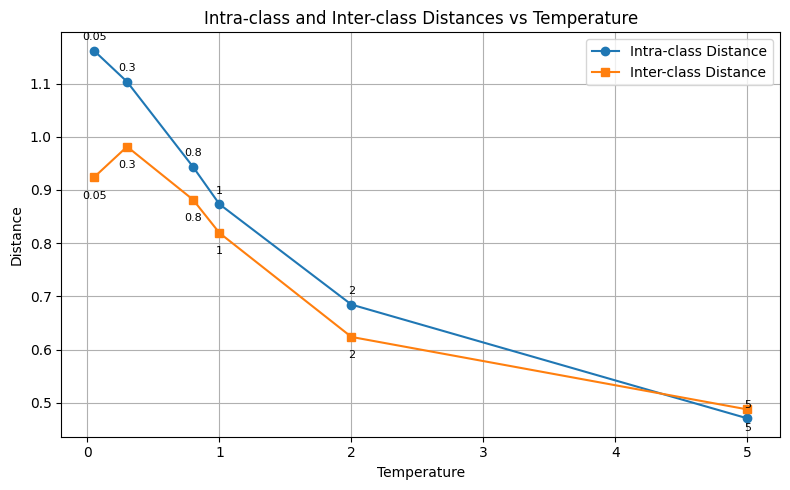

In [ ]:
import matplotlib.pyplot as plt

# Temperature values
temperatures = [0.05, 0.3, 0.8, 1, 2, 5]

# Corresponding distances
intra_class = [1.1617, 1.1034, 0.9434, 0.8733, 0.6846, 0.4708]
inter_class = [0.9239, 0.9814, 0.8817, 0.8192, 0.6238, 0.4876]

# Create the plot
plt.figure(figsize=(8, 5))
plt.plot(temperatures, intra_class, marker='o', label='Intra-class Distance')
plt.plot(temperatures, inter_class, marker='s', label='Inter-class Distance')

# Add temperature labels at each marker
for x, y in zip(temperatures, intra_class):
    plt.text(x, y + 0.02, f'{x}', ha='center', fontsize=8)

for x, y in zip(temperatures, inter_class):
    plt.text(x, y - 0.04, f'{x}', ha='center', fontsize=8)

# Labels and title
plt.xlabel('Temperature')
plt.ylabel('Distance')
plt.title('Intra-class and Inter-class Distances vs Temperature')
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()


# **dVAE Using Temperature Annealing**

### **Initial Temp = 1, Minimum Temp = 0.1, Annealing Rate = 0.03**

-----> Epoch: 0 Average loss: 174.9447
Epoch Temperature 1.0
Original images:


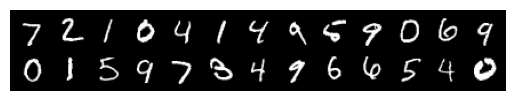

dVAE reconstruction:


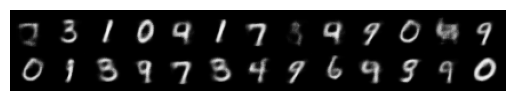

[Temp=1.0] Intra-class distance: 0.8866, Inter-class distance: 0.9534


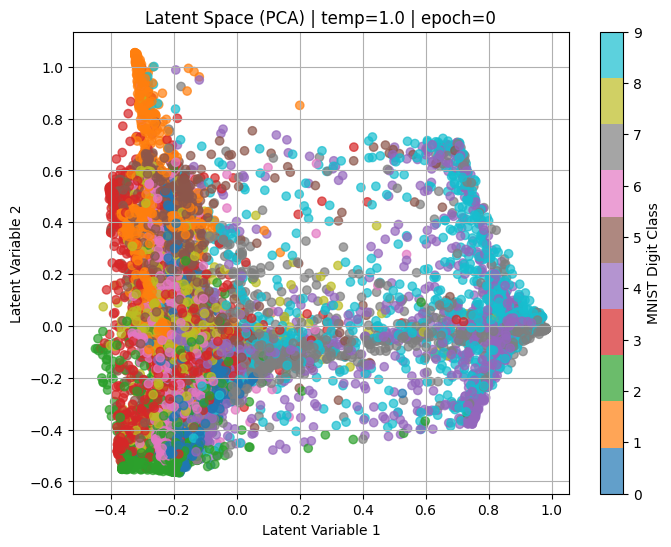

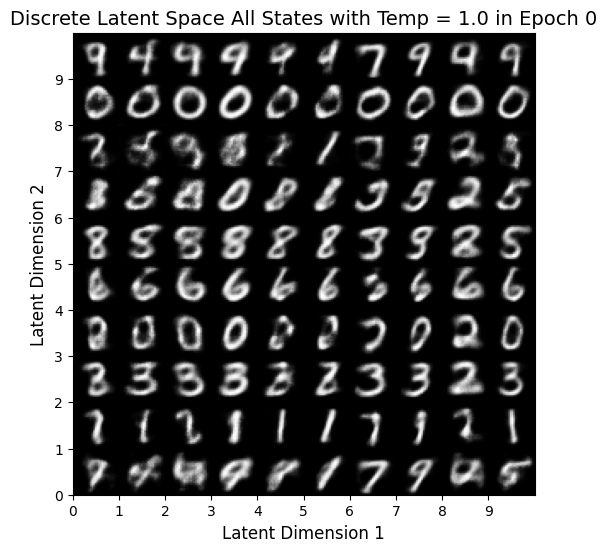

-----> Epoch: 1 Average loss: 142.4769
Epoch Temperature 0.9704455335485082
-----> Epoch: 2 Average loss: 139.4886
Epoch Temperature 0.9417645335842487
-----> Epoch: 3 Average loss: 138.0180
Epoch Temperature 0.9139311852712282
-----> Epoch: 4 Average loss: 137.0402
Epoch Temperature 0.8869204367171575
-----> Epoch: 5 Average loss: 136.2659
Epoch Temperature 0.8607079764250578
[Temp=0.8607079764250578] Intra-class distance: 0.9303, Inter-class distance: 0.9372


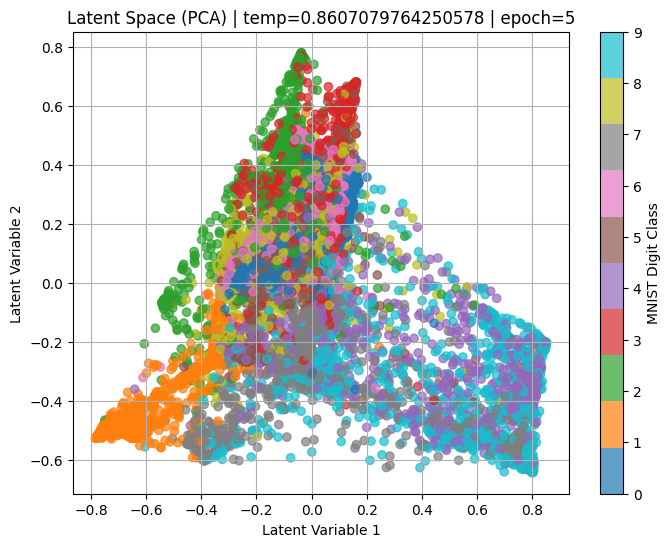

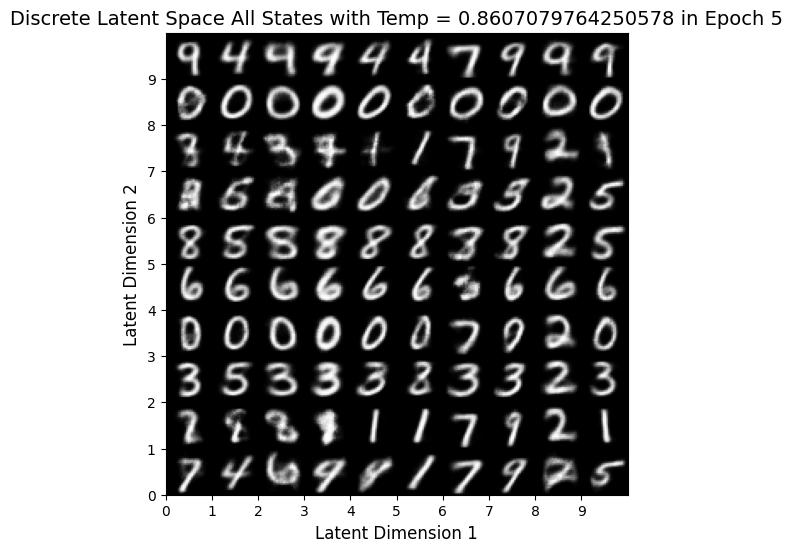

-----> Epoch: 6 Average loss: 135.7042
Epoch Temperature 0.835270211411272
-----> Epoch: 7 Average loss: 135.4907
Epoch Temperature 0.8105842459701871
-----> Epoch: 8 Average loss: 135.3793
Epoch Temperature 0.7866278610665534
-----> Epoch: 9 Average loss: 135.3366
Epoch Temperature 0.7633794943368531
-----> Epoch: 10 Average loss: 135.3351
Epoch Temperature 0.7408182206817179
Original images:


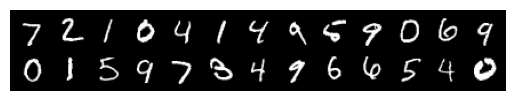

dVAE reconstruction:


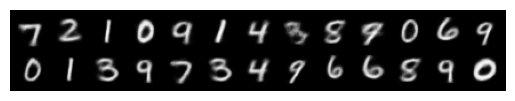

[Temp=0.7408182206817179] Intra-class distance: 0.9595, Inter-class distance: 0.9471


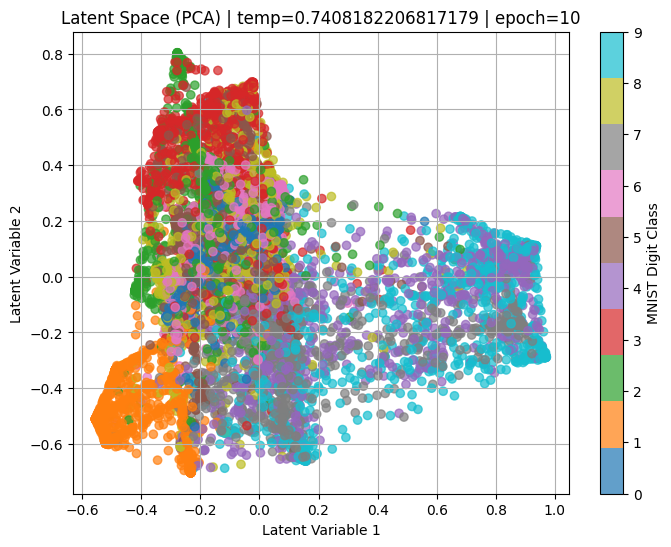

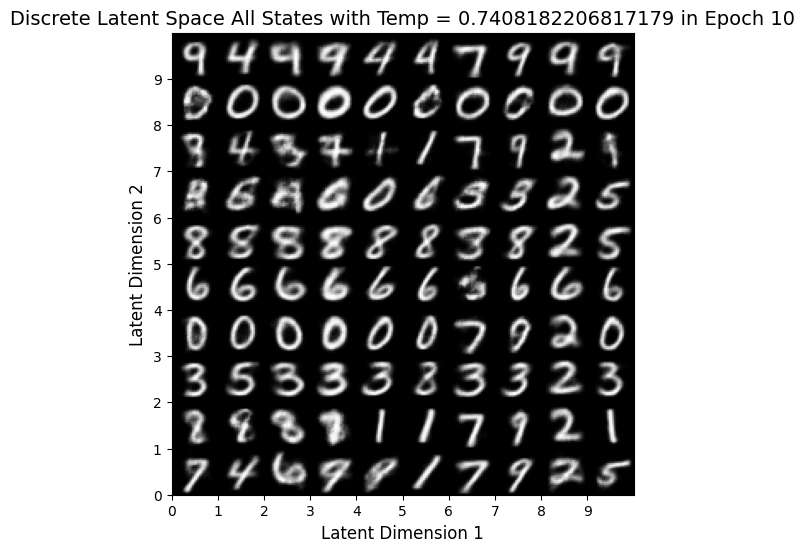

-----> Epoch: 11 Average loss: 135.5367
Epoch Temperature 0.7189237334319262
-----> Epoch: 12 Average loss: 135.7562
Epoch Temperature 0.697676326071031
-----> Epoch: 13 Average loss: 136.1241
Epoch Temperature 0.6770568744981647
-----> Epoch: 14 Average loss: 136.4969
Epoch Temperature 0.6570468198150567
-----> Epoch: 15 Average loss: 136.7873
Epoch Temperature 0.6376281516217733
[Temp=0.6376281516217733] Intra-class distance: 0.9844, Inter-class distance: 0.9405


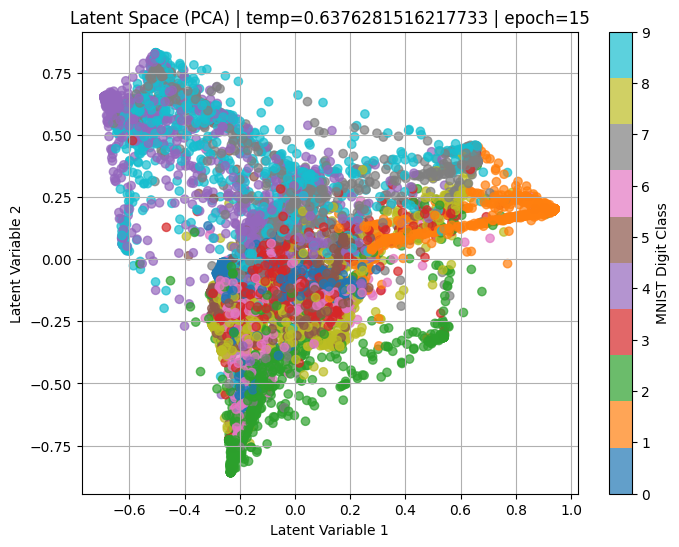

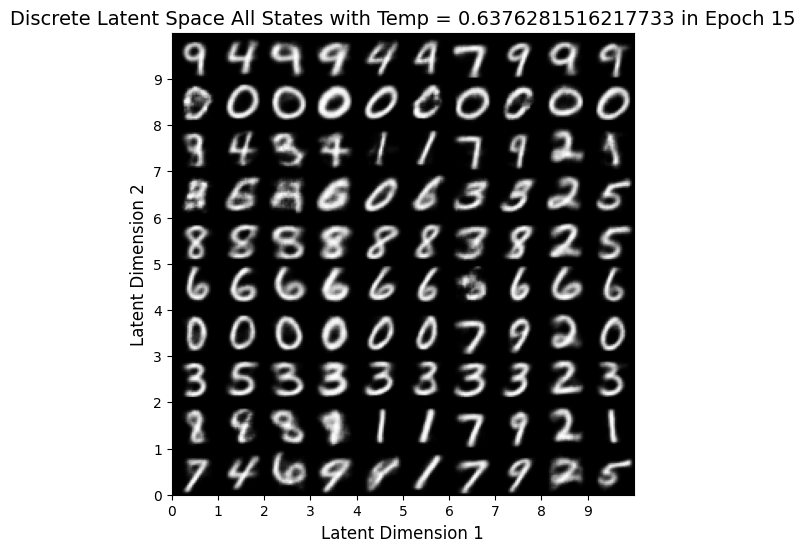

-----> Epoch: 16 Average loss: 137.1309
Epoch Temperature 0.6187833918061408
-----> Epoch: 17 Average loss: 137.6808
Epoch Temperature 0.6004955788122659
-----> Epoch: 18 Average loss: 138.1537
Epoch Temperature 0.5827482523739896
-----> Epoch: 19 Average loss: 138.5292
Epoch Temperature 0.5655254386995371
-----> Epoch: 20 Average loss: 138.9465
Epoch Temperature 0.5488116360940264
Original images:


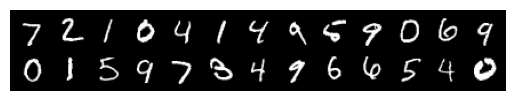

dVAE reconstruction:


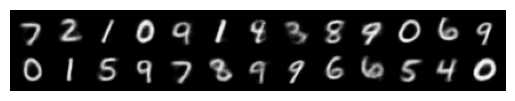

[Temp=0.5488116360940264] Intra-class distance: 1.0056, Inter-class distance: 0.9670


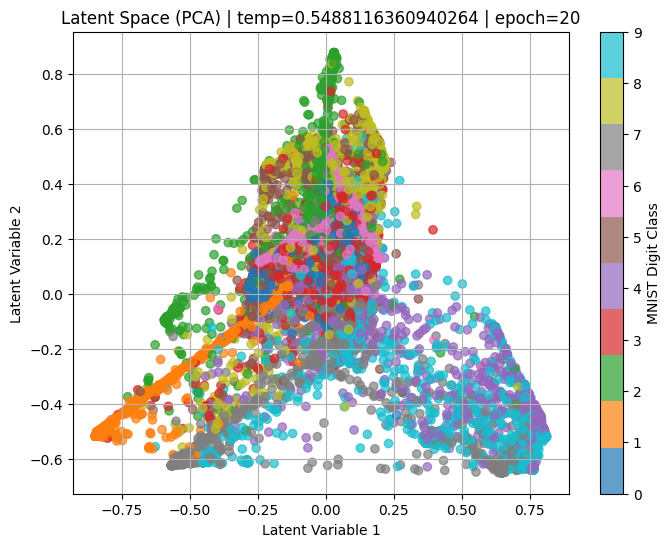

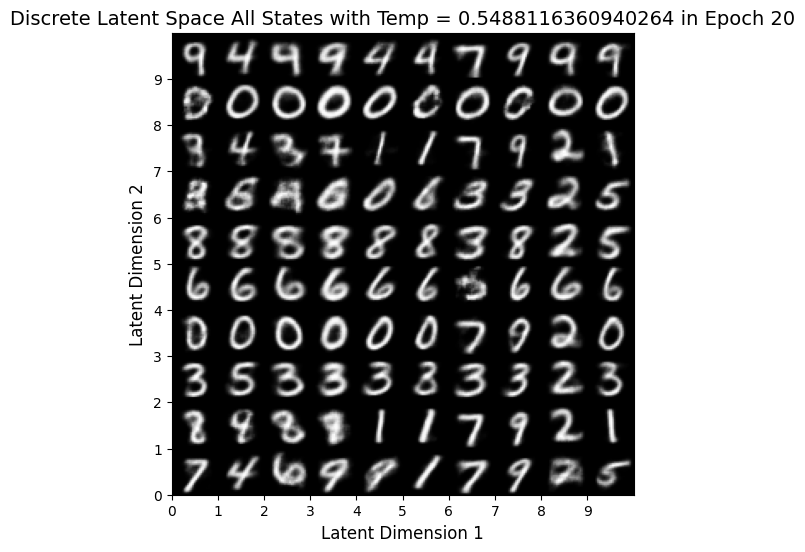

-----> Epoch: 21 Average loss: 139.3555
Epoch Temperature 0.5325918010068972
-----> Epoch: 22 Average loss: 140.0489
Epoch Temperature 0.5168513344916993
-----> Epoch: 23 Average loss: 140.5125
Epoch Temperature 0.5015760690660556
-----> Epoch: 24 Average loss: 140.8975
Epoch Temperature 0.4867522559599717
-----> Epoch: 25 Average loss: 141.5507
Epoch Temperature 0.4723665527410147
[Temp=0.4723665527410147] Intra-class distance: 1.0287, Inter-class distance: 0.9977


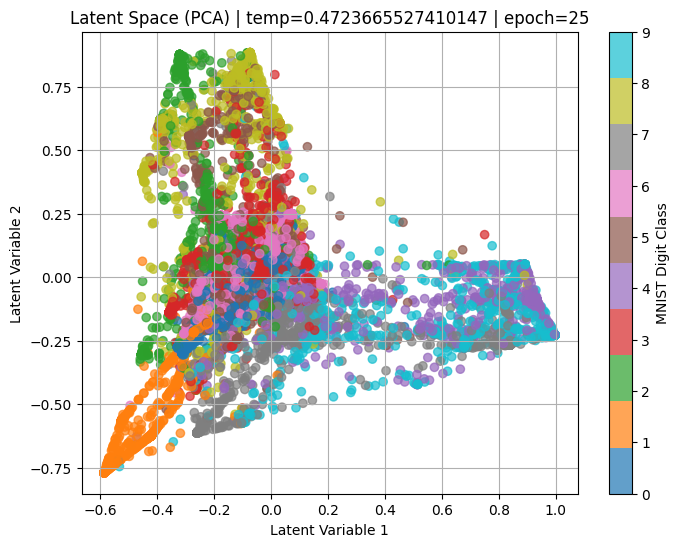

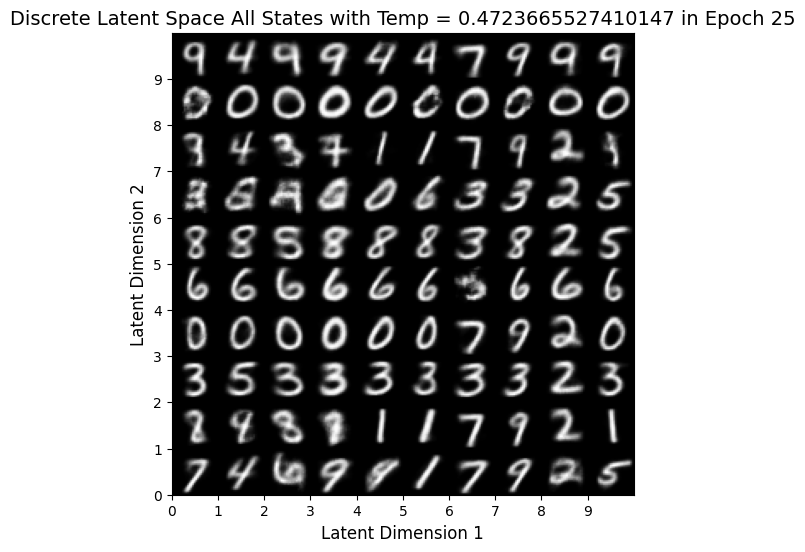

-----> Epoch: 26 Average loss: 142.0329
Epoch Temperature 0.4584060113052235
-----> Epoch: 27 Average loss: 142.6776
Epoch Temperature 0.44485806622294116
-----> Epoch: 28 Average loss: 143.1467
Epoch Temperature 0.43171052342907973
-----> Epoch: 29 Average loss: 143.7483
Epoch Temperature 0.418951549247639
-----> Epoch: 30 Average loss: 144.3625
Epoch Temperature 0.40656965974059917
Original images:


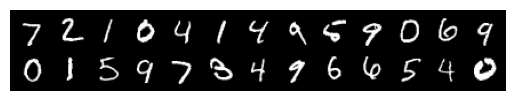

dVAE reconstruction:


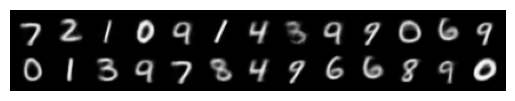

[Temp=0.40656965974059917] Intra-class distance: 1.0487, Inter-class distance: 0.9928


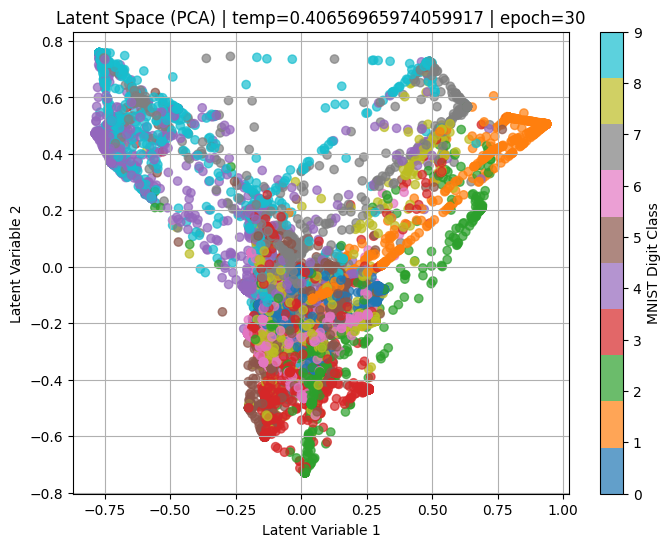

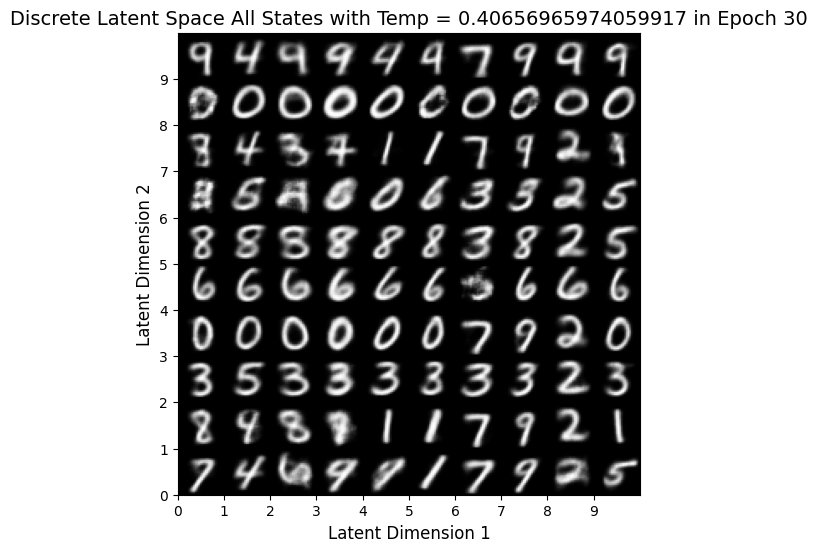

-----> Epoch: 31 Average loss: 144.7042
Epoch Temperature 0.39455371037160114
-----> Epoch: 32 Average loss: 145.2199
Epoch Temperature 0.382892885975112
-----> Epoch: 33 Average loss: 145.7523
Epoch Temperature 0.3715766910220457
-----> Epoch: 34 Average loss: 146.3433
Epoch Temperature 0.3605949401730783
-----> Epoch: 35 Average loss: 146.9518
Epoch Temperature 0.3499377491111553
[Temp=0.3499377491111553] Intra-class distance: 1.0676, Inter-class distance: 0.9886


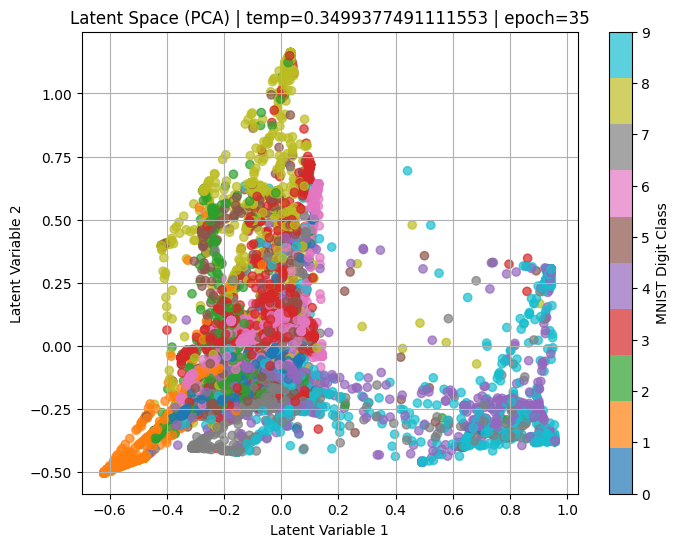

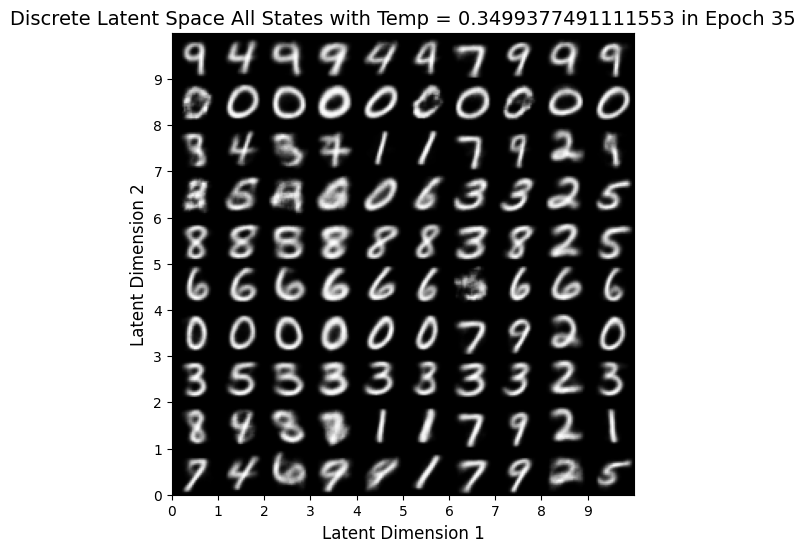

-----> Epoch: 36 Average loss: 147.3995
Epoch Temperature 0.3395955256449391
-----> Epoch: 37 Average loss: 147.9030
Epoch Temperature 0.3295589610751891
-----> Epoch: 38 Average loss: 148.4742
Epoch Temperature 0.3198190218163039
-----> Epoch: 39 Average loss: 148.8930
Epoch Temperature 0.31036694126548503
-----> Epoch: 40 Average loss: 149.6507
Epoch Temperature 0.3011942119122021
Original images:


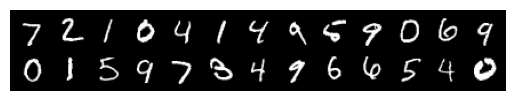

dVAE reconstruction:


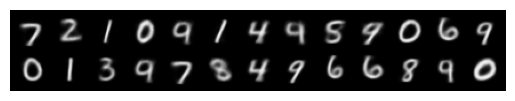

[Temp=0.3011942119122021] Intra-class distance: 1.0709, Inter-class distance: 1.0098


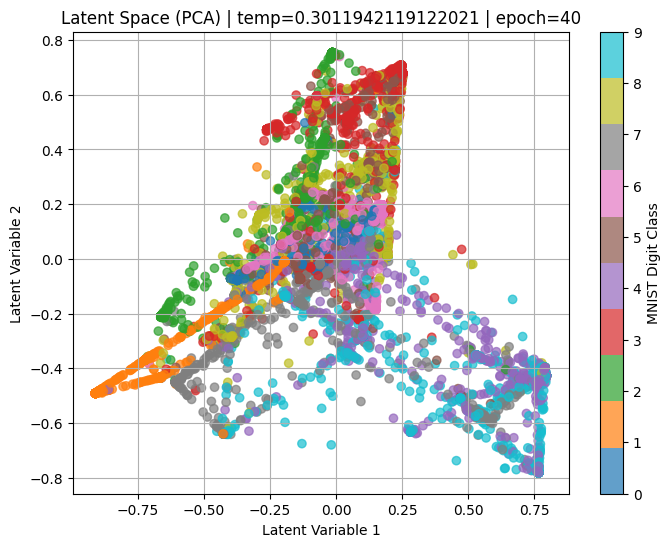

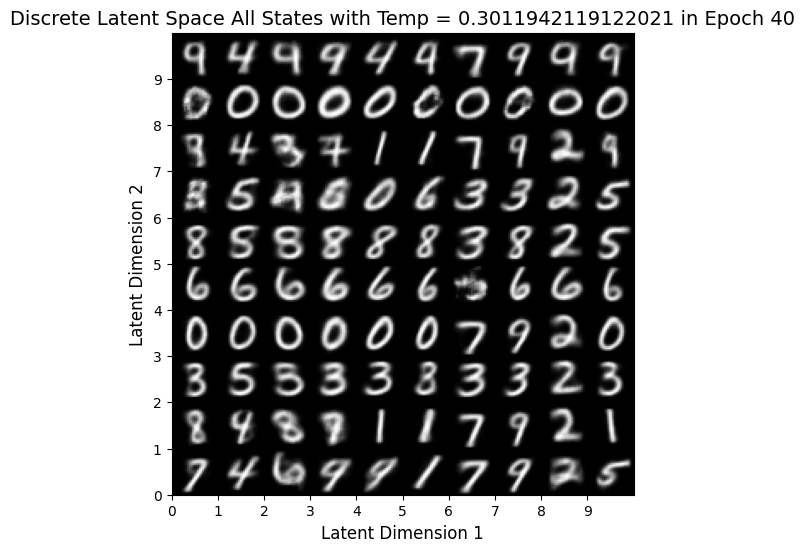

-----> Epoch: 41 Average loss: 149.9986
Epoch Temperature 0.2922925776808594
-----> Epoch: 42 Average loss: 150.5038
Epoch Temperature 0.2836540264997704
-----> Epoch: 43 Average loss: 150.9703
Epoch Temperature 0.27527078308975234
-----> Epoch: 44 Average loss: 151.4966
Epoch Temperature 0.2671353019658504
-----> Epoch: 45 Average loss: 151.9689
Epoch Temperature 0.25924026064589156
[Temp=0.25924026064589156] Intra-class distance: 1.0869, Inter-class distance: 1.0101


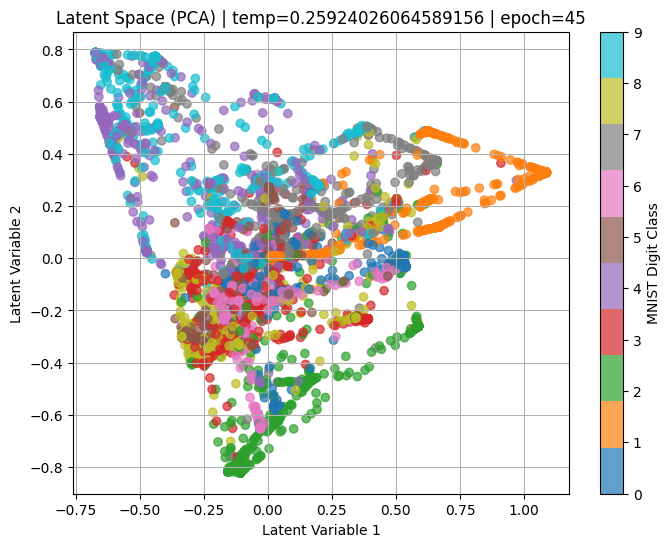

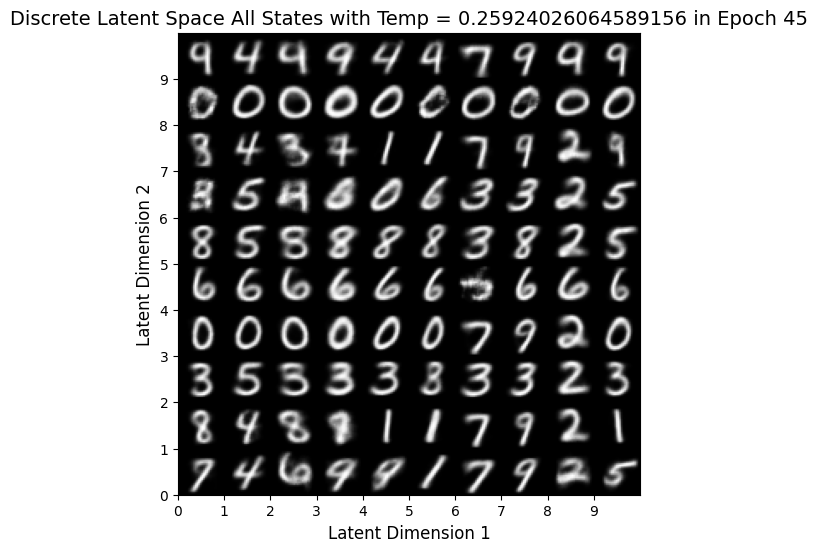

-----> Epoch: 46 Average loss: 152.5179
Epoch Temperature 0.2515785530597565
-----> Epoch: 47 Average loss: 152.9195
Epoch Temperature 0.24414328315343709
-----> Epoch: 48 Average loss: 153.4620
Epoch Temperature 0.23692775868212176
-----> Epoch: 49 Average loss: 154.0044
Epoch Temperature 0.22992548518672384
-----> Epoch: 50 Average loss: 154.2899
Epoch Temperature 0.22313016014842982
Original images:


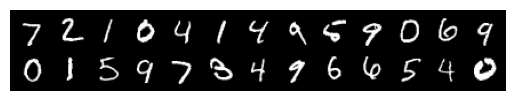

dVAE reconstruction:


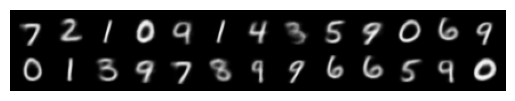

[Temp=0.22313016014842982] Intra-class distance: 1.1003, Inter-class distance: 1.0009


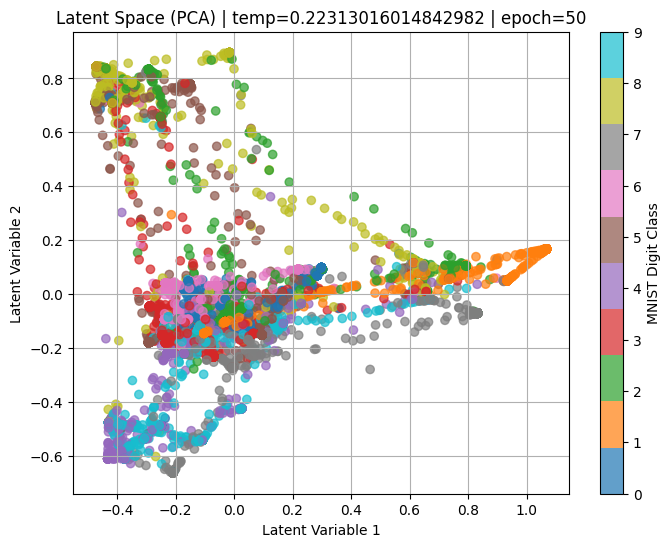

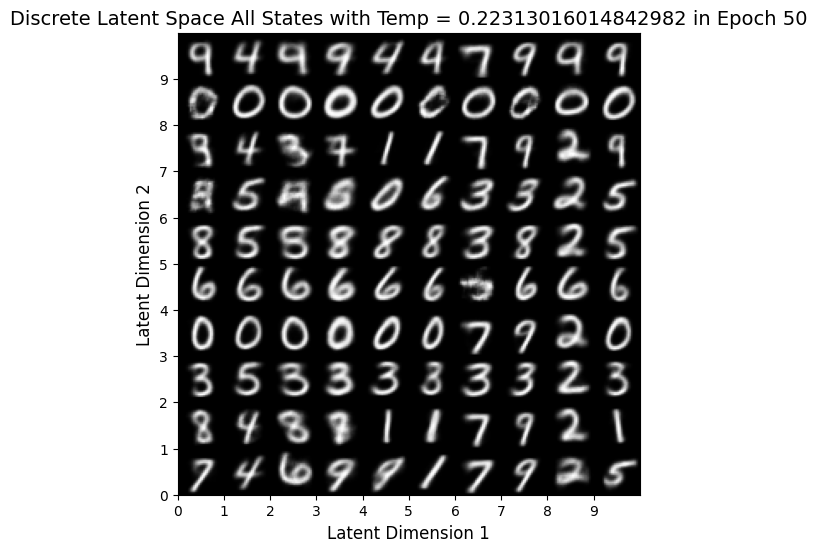

-----> Epoch: 51 Average loss: 154.8014
Epoch Temperature 0.21653566731600707
-----> Epoch: 52 Average loss: 155.3447
Epoch Temperature 0.21013607120076472
-----> Epoch: 53 Average loss: 155.7396
Epoch Temperature 0.20392561173421347
-----> Epoch: 54 Average loss: 156.2344
Epoch Temperature 0.1978986990836147
-----> Epoch: 55 Average loss: 156.7623
Epoch Temperature 0.19204990862075413
[Temp=0.19204990862075413] Intra-class distance: 1.1035, Inter-class distance: 1.0081


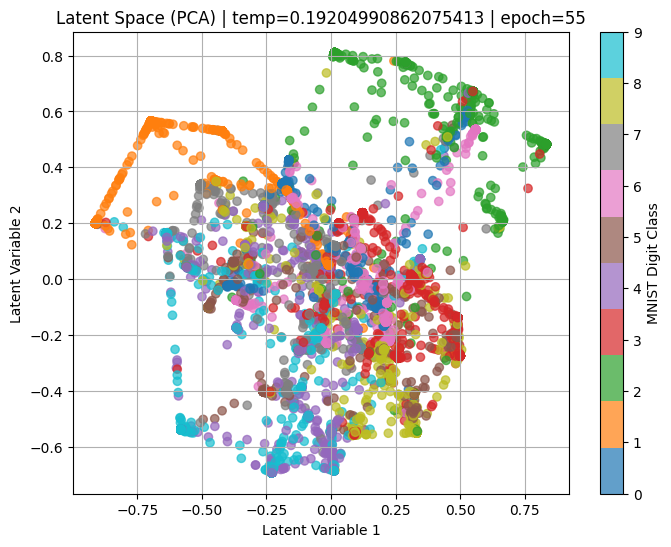

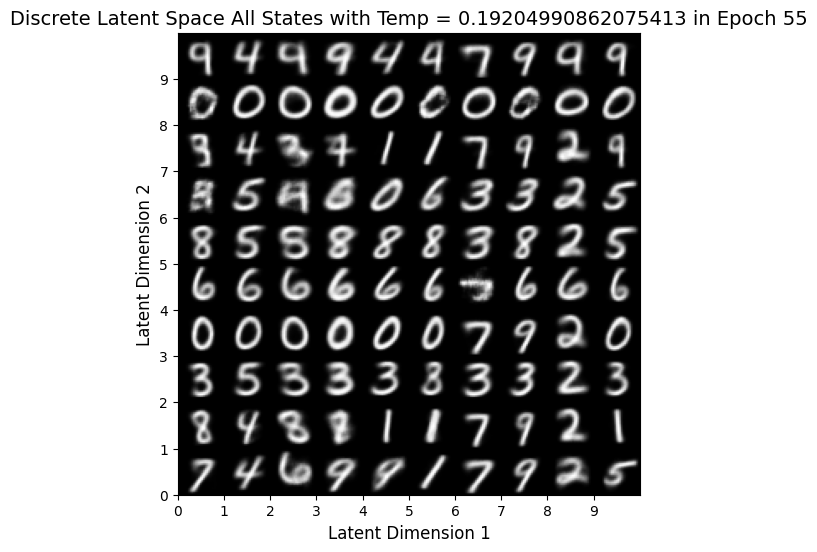

-----> Epoch: 56 Average loss: 157.0569
Epoch Temperature 0.18637397603940997
-----> Epoch: 57 Average loss: 157.4904
Epoch Temperature 0.1808657926171221
-----> Epoch: 58 Average loss: 157.9352
Epoch Temperature 0.17552040061699686
-----> Epoch: 59 Average loss: 158.3107
Epoch Temperature 0.17033298882540943
-----> Epoch: 60 Average loss: 158.6240
Epoch Temperature 0.16529888822158656
Original images:


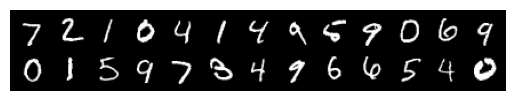

dVAE reconstruction:


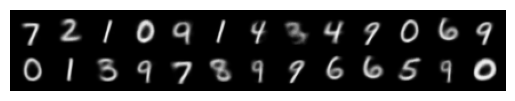

[Temp=0.16529888822158656] Intra-class distance: 1.1005, Inter-class distance: 1.0294


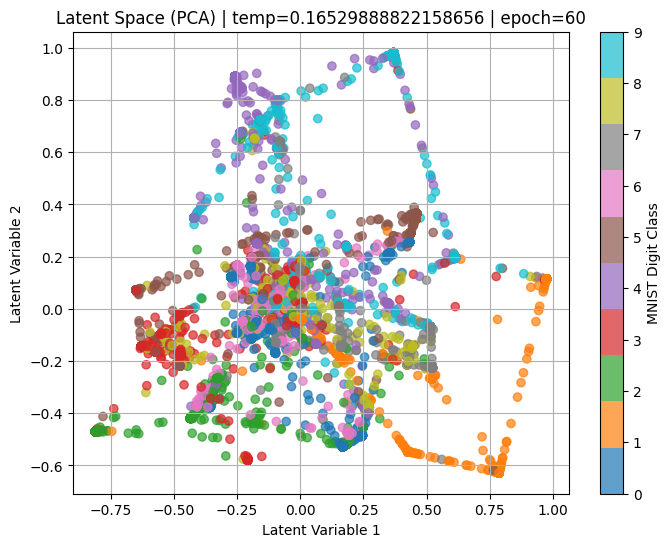

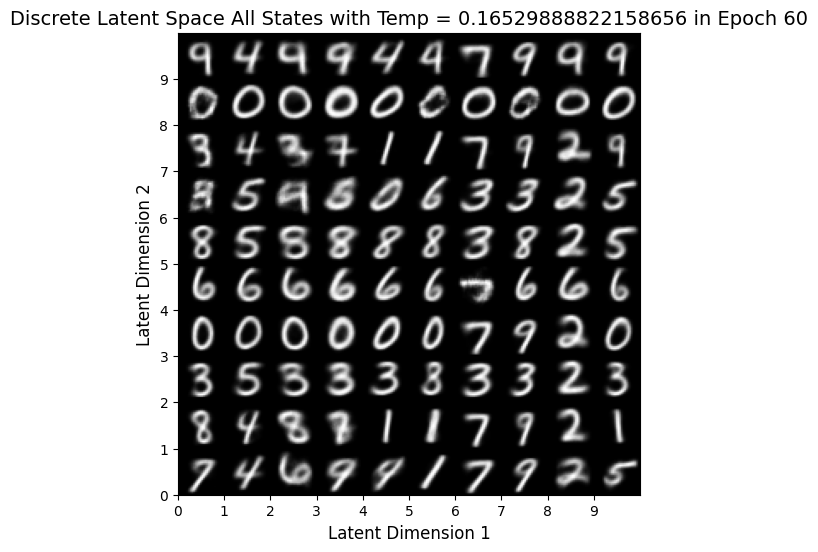

-----> Epoch: 61 Average loss: 158.9941
Epoch Temperature 0.1604135677751728
-----> Epoch: 62 Average loss: 159.4505
Epoch Temperature 0.15567263036799733
-----> Epoch: 63 Average loss: 159.6642
Epoch Temperature 0.15107180883637086
-----> Epoch: 64 Average loss: 159.9772
Epoch Temperature 0.14660696213035015
-----> Epoch: 65 Average loss: 160.3051
Epoch Temperature 0.1422740715865136
[Temp=0.1422740715865136] Intra-class distance: 1.1069, Inter-class distance: 1.0152


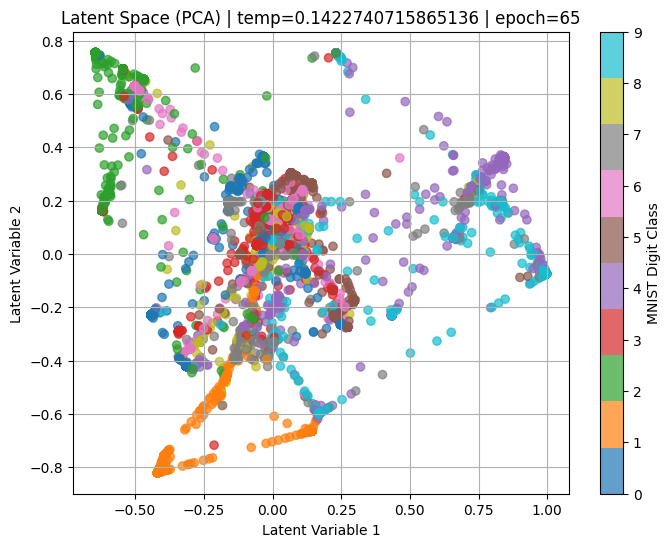

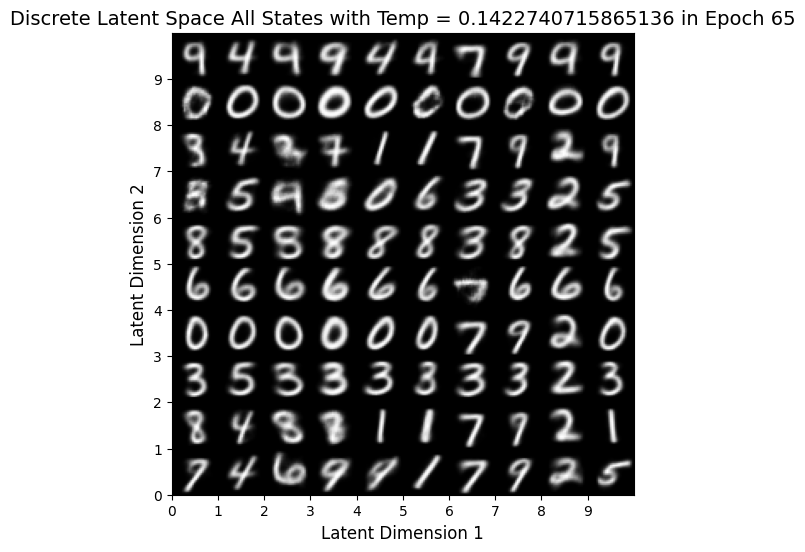

-----> Epoch: 66 Average loss: 160.6070
Epoch Temperature 0.13806923731089282
-----> Epoch: 67 Average loss: 160.9772
Epoch Temperature 0.13398867466880499
-----> Epoch: 68 Average loss: 161.2476
Epoch Temperature 0.1300287108784259
-----> Epoch: 69 Average loss: 161.5365
Epoch Temperature 0.12618578170503877
-----> Epoch: 70 Average loss: 161.8690
Epoch Temperature 0.1224564282529819
Original images:


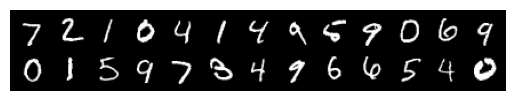

dVAE reconstruction:


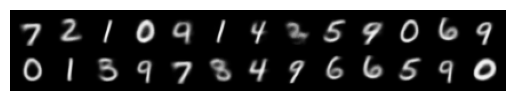

[Temp=0.1224564282529819] Intra-class distance: 1.1110, Inter-class distance: 1.0218


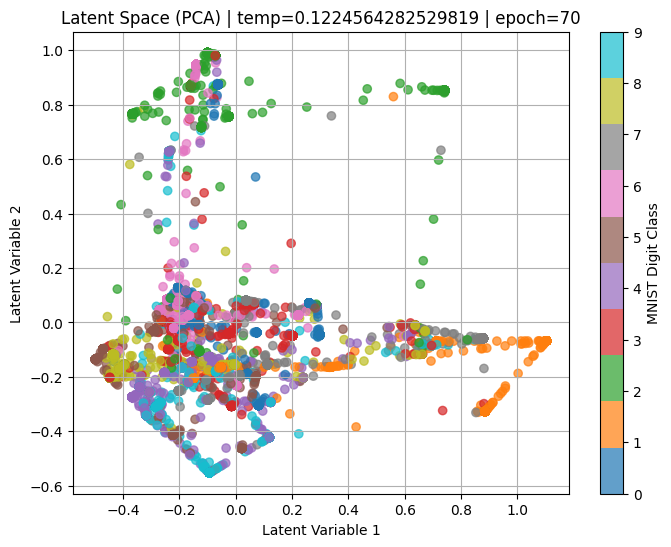

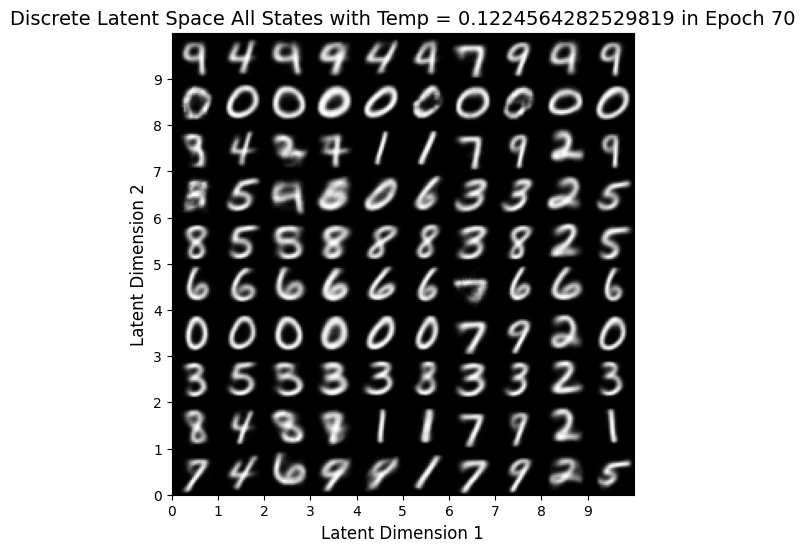

In [ ]:
dVAE_1,test_loader,train_loss_avg = dVAE_Train(1,71,38,min_temp=0.05,anneal_rate = 0.03,anneal=True)

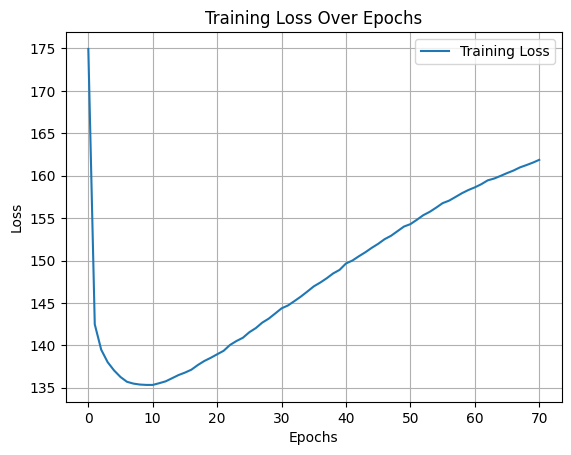

In [ ]:
import matplotlib.pyplot as plt
plt.ion()

fig = plt.figure()
plt.plot(train_loss_avg, label='Training Loss')  # Added a label for clarity
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')  # Added a title
plt.grid(True)  # Enabled the grid
plt.legend()  # Added a legend
plt.show()

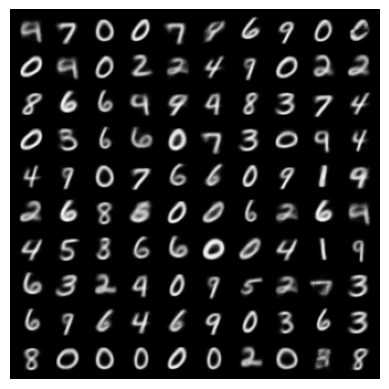

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils

# Function to visualize sampled images from dVAE's discrete latent space
def sample_from_dVAE(dVAE, latent_dim, categorical_dim, device, temp=0.8, num_samples=10):
    dVAE.eval()  # Set model to evaluation mode
    with torch.no_grad():
        # Sample from a uniform categorical distribution (one-hot encoded)
        logits = torch.full((num_samples, latent_dim, categorical_dim), 1.0, device=device)  # Uniform logits
        latent_z = torch.distributions.OneHotCategorical(logits=logits).sample()  # Sample one-hot vectors

        # Flatten categorical latent representation
        latent_z = latent_z.view(num_samples, latent_dim * categorical_dim)



        # Decode images from sampled latent vectors
        img_recon = dVAE.decode(latent_z)
        img_recon = img_recon.cpu()

        # Show reconstructed images
        grid_img = vutils.make_grid(img_recon[:num_samples], nrow=10, padding=5)
        show_image(grid_img)
        plt.show()

# Call function to sample from dVAE
sample_from_dVAE(dVAE_1, latent_dim=2, categorical_dim=10, device=device, temp=0.8, num_samples=100)

# **Continuous Variational Autoencoder (VAE)**

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
latent_dims = 2
num_epochs = 71
batch_size = 128
capacity = 64
learning_rate = 1e-3
variational_beta = 1
use_gpu = True
img_transform = transforms.Compose([
    transforms.ToTensor()
])

train_dataset = MNIST(root='./data/MNIST', download=True, train=True, transform=img_transform)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

test_dataset = MNIST(root='./data/MNIST', download=True, train=False, transform=img_transform)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

In [ ]:
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        c = capacity
        self.conv1 = nn.Conv2d(in_channels=1, out_channels=c, kernel_size=4, stride=2, padding=1) # out: c x 14 x 14
        self.conv2 = nn.Conv2d(in_channels=c, out_channels=c*2, kernel_size=4, stride=2, padding=1) # out: c x 7 x 7
        self.fc_mu = nn.Linear(in_features=c*2*7*7, out_features=latent_dims)
        self.fc_logvar = nn.Linear(in_features=c*2*7*7, out_features=latent_dims)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = x.view(x.size(0), -1) # flatten batch of multi-channel feature maps to a batch of feature vectors
        x_mu = self.fc_mu(x)
        x_logvar = self.fc_logvar(x)
        return x_mu, x_logvar

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()
        c = capacity
        self.fc = nn.Linear(in_features=latent_dims, out_features=c*2*7*7)
        self.conv2 = nn.ConvTranspose2d(in_channels=c*2, out_channels=c, kernel_size=4, stride=2, padding=1)
        self.conv1 = nn.ConvTranspose2d(in_channels=c, out_channels=1, kernel_size=4, stride=2, padding=1)

    def forward(self, x):
        x = self.fc(x)
        x = x.view(x.size(0), capacity*2, 7, 7) # unflatten batch of feature vectors to a batch of multi-channel feature maps
        x = F.relu(self.conv2(x))
        x = torch.sigmoid(self.conv1(x)) # last layer before output is sigmoid, since we are using BCE as reconstruction loss
        return x

class VariationalAutoencoder(nn.Module):
    def __init__(self):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()

    def forward(self, x):
        latent_mu, latent_logvar = self.encoder(x)
        latent = self.latent_sample(latent_mu, latent_logvar)
        x_recon = self.decoder(latent)
        return x_recon, latent_mu, latent_logvar

    def latent_sample(self, mu, logvar):
        if self.training:
            # the reparameterization trick
            std = logvar.mul(0.5).exp_()
            eps = torch.empty_like(std).normal_()
            return eps.mul(std).add_(mu)
        else:
            return mu

def vae_loss(recon_x, x, mu, logvar):
    # recon_x is the probability of a multivariate Bernoulli distribution p.
    # -log(p(x)) is then the pixel-wise binary cross-entropy.
    # Averaging or not averaging the binary cross-entropy over all pixels here
    # is a subtle detail with big effect on training, since it changes the weight
    # we need to pick for the other loss term by several orders of magnitude.
    # Not averaging is the direct implementation of the negative log likelihood,
    # but averaging makes the weight of the other loss term independent of the image resolution.
    recon_loss = F.binary_cross_entropy(recon_x.view(-1, 784), x.view(-1, 784), reduction='sum')

    # KL-divergence between the prior distribution over latent vectors
    # (the one we are going to sample from when generating new images)
    # and the distribution estimated by the generator for the given image.
    kldivergence = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return recon_loss + variational_beta * kldivergence


vae = VariationalAutoencoder()

device = torch.device("cuda:0" if use_gpu and torch.cuda.is_available() else "cpu")
vae = vae.to(device)

num_params = sum(p.numel() for p in vae.parameters() if p.requires_grad)
print('Number of parameters: %d' % num_params)

Number of parameters: 308357


# **Train VAE**

In [ ]:
optimizer = torch.optim.Adam(params=vae.parameters(), lr=learning_rate, weight_decay=1e-5)

# set to training mode
vae.train()

train_loss_avg = []

print('Training ...')
for epoch in range(num_epochs):
    train_loss_avg.append(0)
    num_batches = 0

    for image_batch, _ in train_dataloader:

        image_batch = image_batch.to(device)

        # vae reconstruction
        image_batch_recon, latent_mu, latent_logvar = vae(image_batch)

        # reconstruction error
        loss = vae_loss(image_batch_recon, image_batch, latent_mu, latent_logvar)

        # backpropagation
        optimizer.zero_grad()
        loss.backward()

        # one step of the optmizer (using the gradients from backpropagation)
        optimizer.step()

        train_loss_avg[-1] += loss.item()
        num_batches += 1

    train_loss_avg[-1] /= num_batches
    print('Epoch [%d / %d] average reconstruction error: %f' % (epoch+1, num_epochs, train_loss_avg[-1]))

Training ...
Epoch [1 / 71] average reconstruction error: 24122.207281
Epoch [2 / 71] average reconstruction error: 21558.617829
Epoch [3 / 71] average reconstruction error: 20863.260434
Epoch [4 / 71] average reconstruction error: 20453.239997
Epoch [5 / 71] average reconstruction error: 20206.147065
Epoch [6 / 71] average reconstruction error: 20046.206675
Epoch [7 / 71] average reconstruction error: 19936.075768
Epoch [8 / 71] average reconstruction error: 19851.765061
Epoch [9 / 71] average reconstruction error: 19762.882608
Epoch [10 / 71] average reconstruction error: 19711.736005
Epoch [11 / 71] average reconstruction error: 19644.015019
Epoch [12 / 71] average reconstruction error: 19591.997989
Epoch [13 / 71] average reconstruction error: 19544.305608
Epoch [14 / 71] average reconstruction error: 19499.821185
Epoch [15 / 71] average reconstruction error: 19450.985433
Epoch [16 / 71] average reconstruction error: 19427.366013
Epoch [17 / 71] average reconstruction error: 19382.

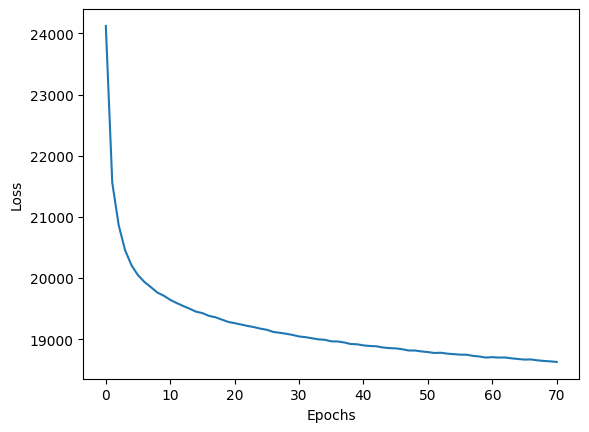

In [ ]:
import matplotlib.pyplot as plt
plt.ion()

fig = plt.figure()
plt.plot(train_loss_avg)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.show()

Original images


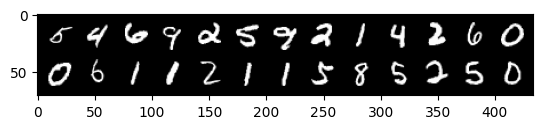

VAE reconstruction:


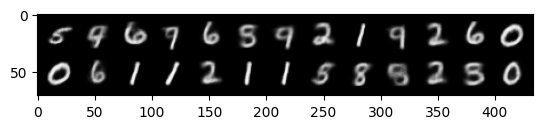

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torchvision.utils

plt.ion()

vae.eval()

# Function to clamp values between 0 and 1
def to_img(x):
    x = x.clamp(0, 1)
    return x

# Function to display an image
def show_image(img):
    img = to_img(img)
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))

# Function to visualize reconstructed images
def visualise_output(images, model):
    with torch.no_grad():
        images = images.to(device)
        images, _, _ = model(images)  # VAE outputs reconstructed images
        images = images.cpu()
        images = to_img(images)
        np_imagegrid = torchvision.utils.make_grid(images[:26], nrow=13, padding=5).numpy()  # Fix slicing
        plt.imshow(np.transpose(np_imagegrid, (1, 2, 0)))
        plt.show()

# Fetch images from the dataloader correctly
images, labels = next(iter(test_dataloader))  # Fix the incorrect `.next()`

# Display original images
print('Original images')
show_image(torchvision.utils.make_grid(images[:26], nrow=13, padding=5))  # Fix slicing
plt.show()

# Reconstruct and visualize using the VAE
print('VAE reconstruction:')
visualise_output(images, vae)


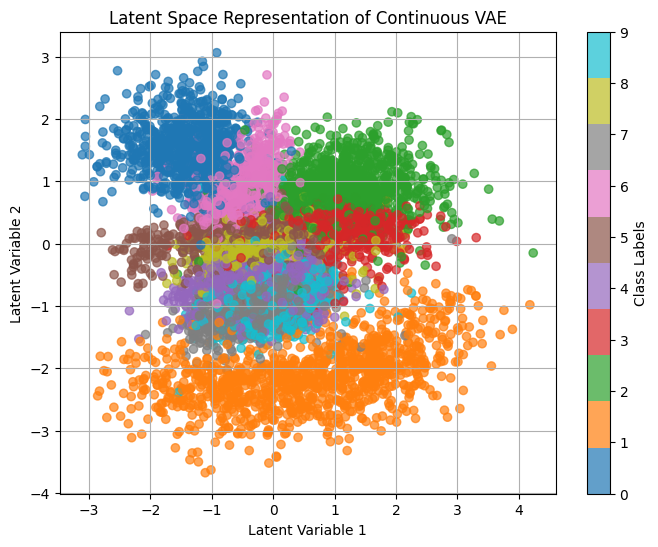

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np

def plot_latent_space(vae, dataloader, device, num_batches=100):
    """Plots the latent space representation of the test dataset."""

    vae.eval()

    all_latents = []
    all_labels = []

    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            images = images.to(device)

            # Forward pass through the encoder
            mean, log_var = vae.encoder(images)  # Ensure your VAE encoder returns (mean, log_var)
            z = mean  # We use mean instead of sampling for visualization

            all_latents.append(z.cpu().numpy())
            all_labels.append(labels.cpu().numpy())

            if i >= num_batches:  # Limit batches for performance
                break

    # Convert lists to numpy arrays
    latents = np.concatenate(all_latents, axis=0)
    labels = np.concatenate(all_labels, axis=0)

    # Plot the 2D latent space
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(latents[:, 0], latents[:, 1], c=labels, cmap='tab10', alpha=0.7)
    plt.colorbar(scatter, label="Class Labels")
    plt.xlabel("Latent Variable 1")
    plt.ylabel("Latent Variable 2")
    plt.title("Latent Space Representation of Continuous VAE")
    plt.grid(True)
    plt.show()
plot_latent_space(vae, test_dataloader, device)


